In [ ]:
Bernat Sort Rufat
MD004_Advanced data analysis and visualization tools
Máster en Data Science

# Trabajo del Tema 6: Análisis de Componentes Principales (PCA)

Objetivos:

1. **Visualización y familiarización del dataset**: Se valorará el uso de las técnicas empleadas, así como la explicación de las visualizaciones / estadísticos utilizados en clases anteriores.
2. **Análisis de correlación y de componentes principales**: Se valorará principalmente la interpretación de dichos análisis así como la “limpieza” de la presentación
3. **Análisis de ANOVA**: Se valorará principalmente la interpretación del análisis, así como la limpieza de los datos
4. **Desarrollo y justificación de las variables**: En base a las conclusiones sacadas en los puntos 1, 2, y 3 ¿Qué variables debemos utilizar en nuestro modelo de regresión lineal?
5. **Estudio de regresión lineal del median_value**: ¿Qué resultados obtenemos en el modelo?,  ¿Predice correctamente?, ¿Utilizarías este modelo en la vida real? 


Por tanto, nuestro objetivo es construir un modelo de regresión lineal múltiple para poder predecir el valor medio del precio de las viviendas de Boston, a partir de una serie variables predictoras. 

## Carga de packages

In [ ]:
library(ggplot2)

# install.packages('gridExtra')
library(gridExtra)

# install.packages ('GGally')
library(GGally)

library(caret)

library(dplyr)

# install.packages('nortest')
library(nortest)

# install.packages('regclass')
library(regclass)

library(lmtest)

## Carga de datos

In [91]:
# cargamos los datos en el df
boston_data <- read.csv(file="20230119_DatosBoston.csv", header=TRUE, sep=";", dec=".")

## Exploratory Data Analysis

El fichero 20230119_DatosBoston incluye datos de precios del mercado de viviendas de Boston (median_value), así como datos adicionales sobre la ubicación de la vivienda y otros datos sociodemográficos. Incluye 506 instancias y 14 variables.

<u>Descripción variables<u>
- **crime_index**: Índice de criminalidad de la zona
- **urban_ratio**: Ratio de zona urbana residencial sobre el total
- **industry_ratio**: Ratio de industria de la zona
- **c_river_variable**: 1 si la zona colinda con un río y 0 si no
- **nox_concentration**: Concentración de óxido nitroso en la zona
- **rooms_per_dwelling**: Número de habitaciones medio por vivienda
- **dwelling_age**: “Edad” media de la vivienda
- **dwelling_dist**: Distancia media ponderada con los centros urbanos de la ciudad
- **highway_index**: Índice de accesibilidad sobre autopistas cercanas
- **tax_ratio**: Índice de tasas por cada 10000usd
- **teacher_ratio**: Ratio de alumno por profesor
- **racial_index**: Índice de proporción de población no caucásica
- **lower_status**: Porcentaje de población de “clase-baja”
- **median_value**: Valor medio de precio de la vivienda (En 1000USD)

In [92]:
head(boston_data) # de forma predefinida retorna las primeras 6 observations
tail(boston_data) # de forma predefinida retorna las últimas 6 observations

,crime_index,urban_ratio,industry_ratio,c_river_variable,nox_concentration,rooms_per_dwelling,dwelling_age,dwelling_dist,highway_index,tax_ratio,teacher_ratio,racial_index,lower_status,median_value
,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
1,0.00632,18,2.31,0,0.538,6.575,65.2,4.090,1,296,15.3,396.90,4.98,24.0
2,0.02731,0,7.07,0,0.469,6.421,78.9,49.671,2,242,17.8,396.90,9.14,21.6
3,0.02729,0,7.07,0,0.469,7.185,61.1,49.671,2,242,17.8,392.83,4.03,34.7
4,0.03237,0,2.18,0,0.458,6.998,45.8,60.622,3,222,18.7,394.63,2.94,33.4
5,0.06905,0,2.18,0,0.458,7.147,54.2,60.622,3,222,18.7,396.90,5.33,36.2
6,0.02985,0,2.18,0,0.458,6.430,58.7,60.622,3,222,18.7,394.12,5.21,28.7


,crime_index,urban_ratio,industry_ratio,c_river_variable,nox_concentration,rooms_per_dwelling,dwelling_age,dwelling_dist,highway_index,tax_ratio,teacher_ratio,racial_index,lower_status,median_value
,<dbl>,<dbl>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
501,0.22438,0,9.69,0,0.585,6.027,79.7,24.982,6,391,19.2,396.90,14.33,16.8
502,0.06263,0,11.93,0,0.573,6.593,69.1,24.786,1,273,21.0,391.99,9.67,22.4
503,0.04527,0,11.93,0,0.573,6.120,76.7,22.875,1,273,21.0,396.90,9.08,20.6
504,0.06076,0,11.93,0,0.573,6.976,91.0,21.675,1,273,21.0,396.90,5.64,23.9
505,0.10959,0,11.93,0,0.573,6.794,89.3,23.889,1,273,21.0,393.45,6.48,22.0
506,0.04741,0,11.93,0,0.573,6.030,80.8,2.505,1,273,21.0,396.90,7.88,11.9


In [93]:
# dimensión del df (filas y columnas)
dim(boston_data)

[1] 506  14

- El dataset incluye 506 instancias (filas) y 14 variables (columnas).

In [94]:
# estructura interna compacta del df
str(boston_data)

'data.frame':	506 obs. of  14 variables:
 $ crime_index       : num  0.00632 0.02731 0.02729 0.03237 0.06905 ...
 $ urban_ratio       : num  18 0 0 0 0 0 12.5 12.5 12.5 12.5 ...
 $ industry_ratio    : num  2.31 7.07 7.07 2.18 2.18 2.18 7.87 7.87 7.87 7.87 ...
 $ c_river_variable  : int  0 0 0 0 0 0 0 0 0 0 ...
 $ nox_concentration : num  0.538 0.469 0.469 0.458 0.458 0.458 0.524 0.524 0.524 0.524 ...
 $ rooms_per_dwelling: num  6.58 6.42 7.18 7 7.15 ...
 $ dwelling_age      : num  65.2 78.9 61.1 45.8 54.2 58.7 66.6 96.1 100 85.9 ...
 $ dwelling_dist     : num  4.09 49.67 49.67 60.62 60.62 ...
 $ highway_index     : int  1 2 2 3 3 3 5 5 5 5 ...
 $ tax_ratio         : int  296 242 242 222 222 222 311 311 311 311 ...
 $ teacher_ratio     : num  15.3 17.8 17.8 18.7 18.7 18.7 15.2 15.2 15.2 15.2 ...
 $ racial_index      : num  397 397 393 395 397 ...
 $ lower_status      : num  4.98 9.14 4.03 2.94 5.33 ...
 $ median_value      : num  24 21.6 34.7 33.4 36.2 28.7 22.9 27.1 16.5 18.9 ...


- Observamos que c_river_variable en realidad es categórica:
    - 0: zona no colinda con río
    - 1: zona colinda con río


In [12]:
# visión general del df
summary(boston_data)

  crime_index        urban_ratio     industry_ratio  c_river_variable 
 Min.   :  0.0063   Min.   :  0.00   Min.   : 0.46   Min.   :0.00000  
 1st Qu.:  0.0820   1st Qu.:  0.00   1st Qu.: 5.19   1st Qu.:0.00000  
 Median :  0.2565   Median :  0.00   Median : 9.69   Median :0.00000  
 Mean   :131.6957   Mean   : 11.36   Mean   :11.14   Mean   :0.06917  
 3rd Qu.:143.3370   3rd Qu.: 12.50   3rd Qu.:18.10   3rd Qu.:0.00000  
 Max.   :996.6540   Max.   :100.00   Max.   :27.74   Max.   :1.00000  
 nox_concentration rooms_per_dwelling  dwelling_age    dwelling_dist    
 Min.   :0.3850    Min.   :3.561      Min.   :  2.90   Min.   :  1.137  
 1st Qu.:0.4490    1st Qu.:5.886      1st Qu.: 45.02   1st Qu.: 17.930  
 Median :0.5380    Median :6.208      Median : 77.50   Median : 27.533  
 Mean   :0.5547    Mean   :6.285      Mean   : 68.57   Mean   : 33.837  
 3rd Qu.:0.6240    3rd Qu.:6.623      3rd Qu.: 94.08   3rd Qu.: 47.648  
 Max.   :0.8710    Max.   :8.780      Max.   :100.00   Max.   :12

La función summary() proporciona algunas estadísticas básicas para cada variable del conjunto de datos.
- c_river_variable en realidad es categórica, solo toma los valores de 0 y 1. 
- Podemos ver que las variables crime_index, racial_index y tax_ratio tienen un amplio rango de valores y presentan una gran diferencia entre la mediana y la media.



In [11]:
# miramos si hay valores nulos
sum(is.na(boston_data))

[1] 0

- Observamos que no hay valores nulos en el dataset. 

### Variable Objetivo

- Variable objetivo: median_value

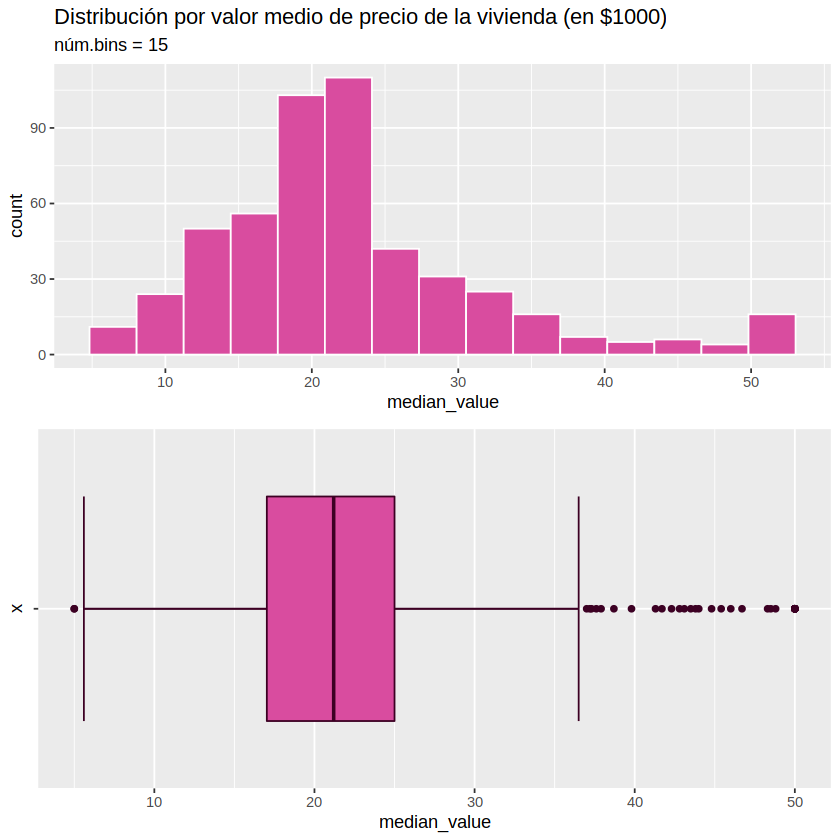

In [4]:
a= ggplot(boston_data) + # señalamos el dataframe
  aes(x = median_value) + # indicamos la variable 
  geom_histogram(bins = 15 ,fill = "#d94c9f",color = "white") + #color del contorno
  labs(title="Distribución por valor medio de precio de la vivienda (en $1000)"  ,subtitle = "núm.bins = 15",x = "median_value")  #nombre variable eje x
b= ggplot(data = boston_data, aes(x = "", y = median_value)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip() # Boxplot horizontal
grid.arrange(a,b)

- La variable objetivo median_value (valor medio del precio de la vivienda (en 1000USD)) oscila entre 5.000 y 50.000 dólares, con una mediana de 21.200 dólares y una media de 22.530 dólares. 

- La diferencia entre la mediana y la media puede indicar la presencia de valores atípicos, ya que estos pueden aumentar significativamente la media pero no la mediana. Podemos observar mirando la distribución de los datos que efectivamente tenemos outliers. 


### Variables explicativas

- **crime_index**: Índice de criminalidad de la zona
- **urban_ratio**: Ratio de zona urbana residencial sobre el total
- **industry_ratio**: Ratio de industria de la zona
- **nox_concentration**: Concentración de óxido nitroso en la zona
- **rooms_per_dwelling**: Número de habitaciones medio por vivienda
- **dwelling_age**: “Edad” media de la vivienda
- **dwelling_dist**: Distancia media ponderada con los centros urbanos de la ciudad
- **highway_index**: Índice de accesibilidad sobre autopistas cercanas
- **tax_ratio**: Índice de tasas por cada 10000usd
- **teacher_ratio**: Ratio de alumno por profesor
- **racial_index**: Índice de proporción de población no caucásica
- **lower_status**: Porcentaje de población de “clase-baja”

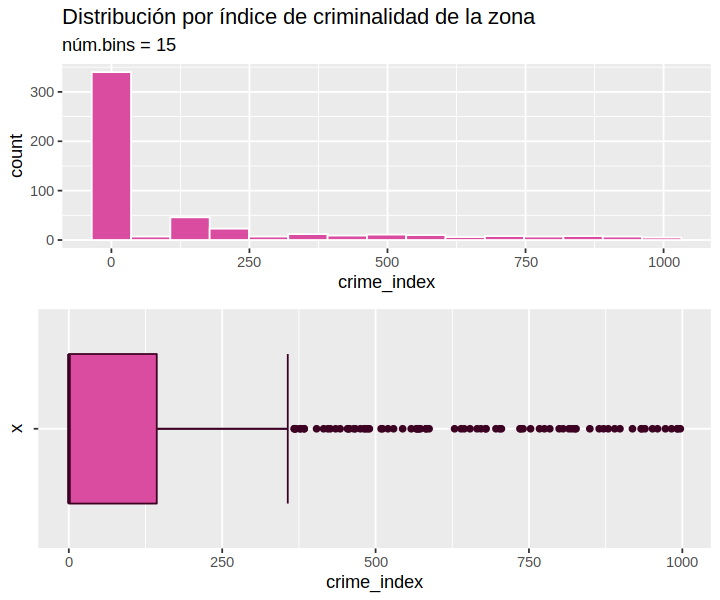

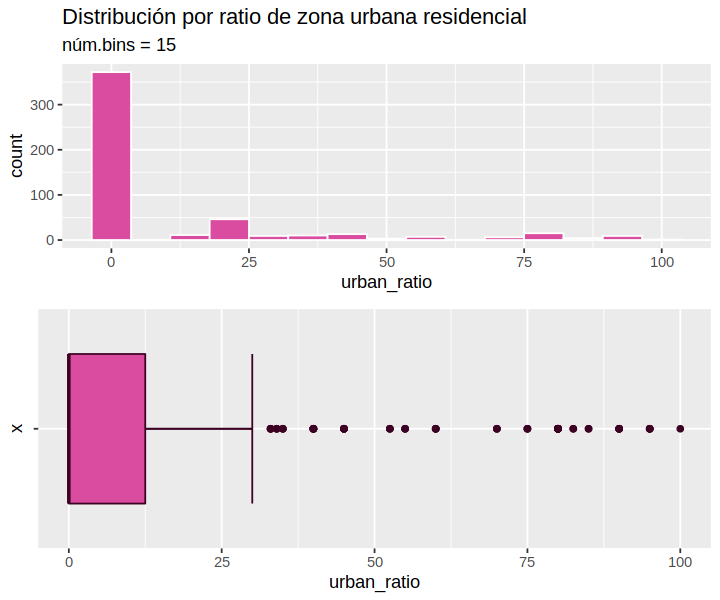

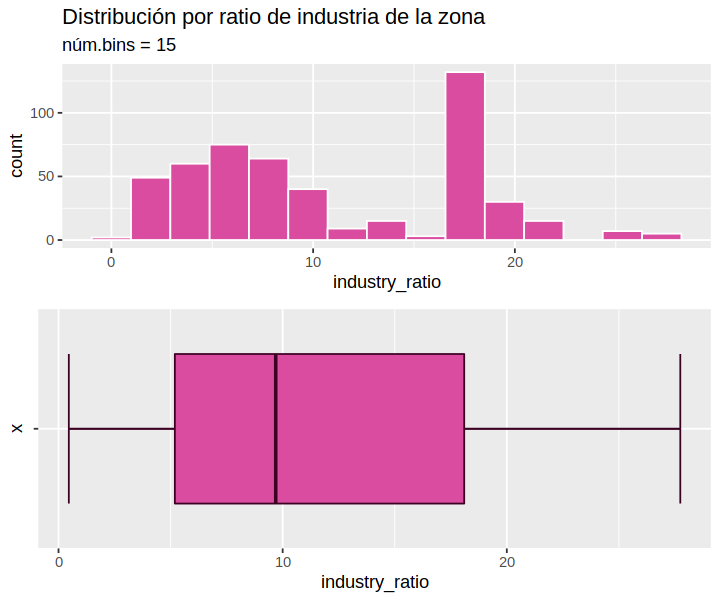

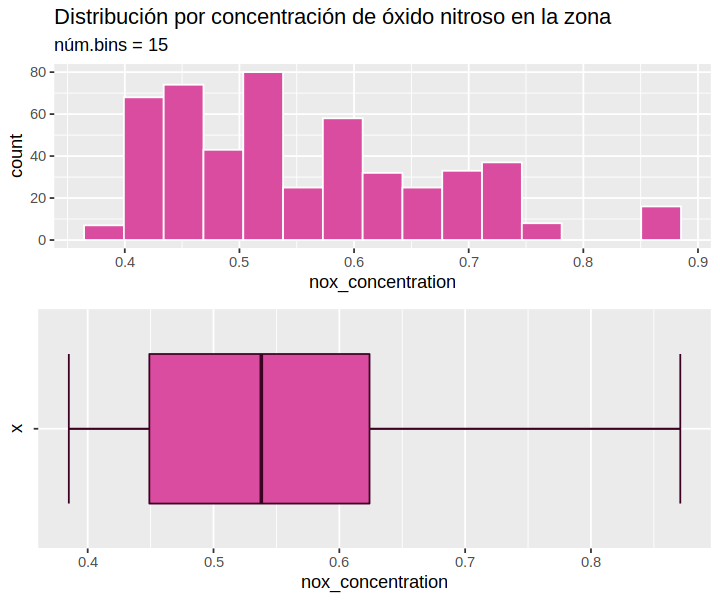

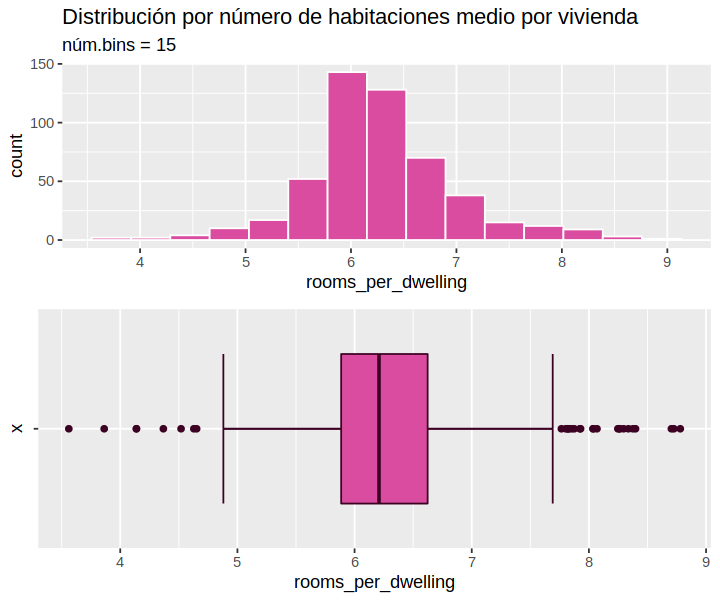

...

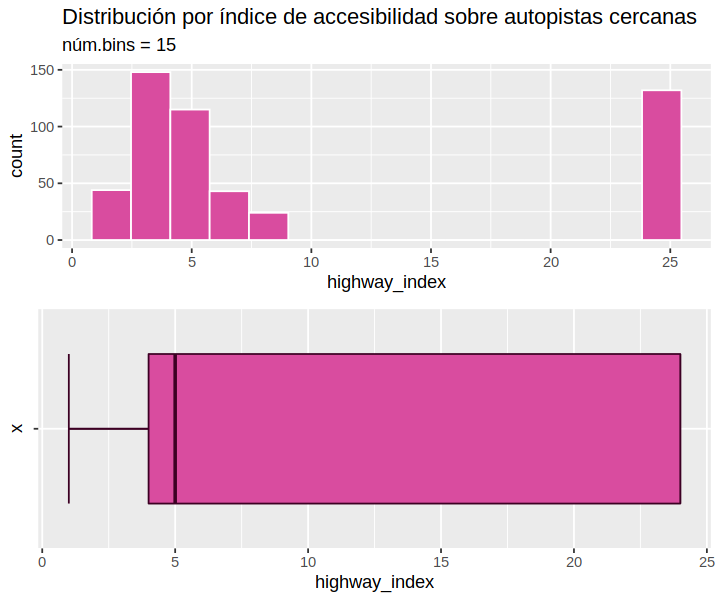

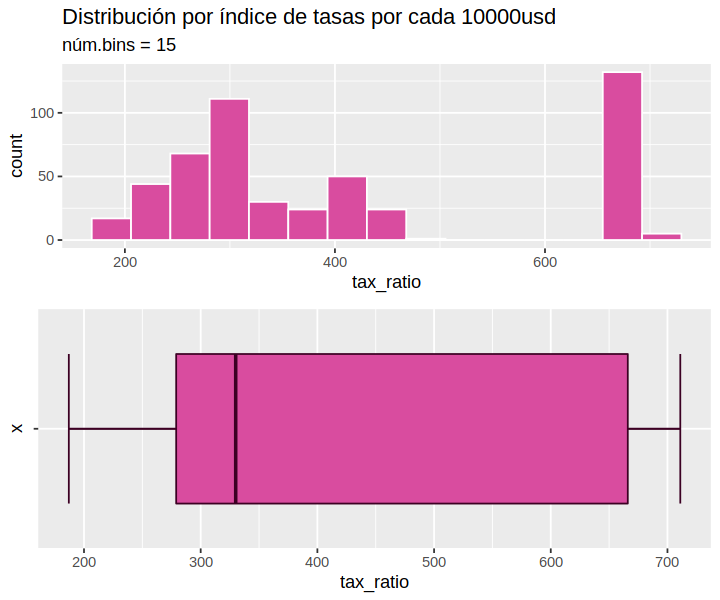

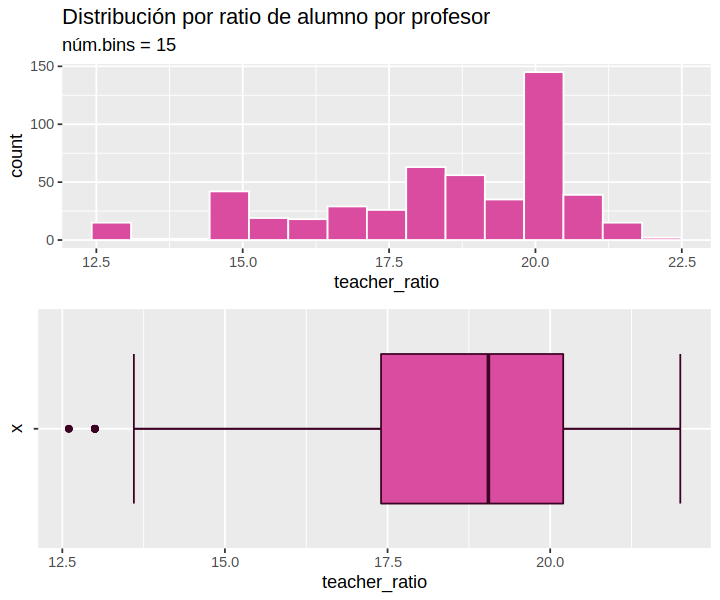

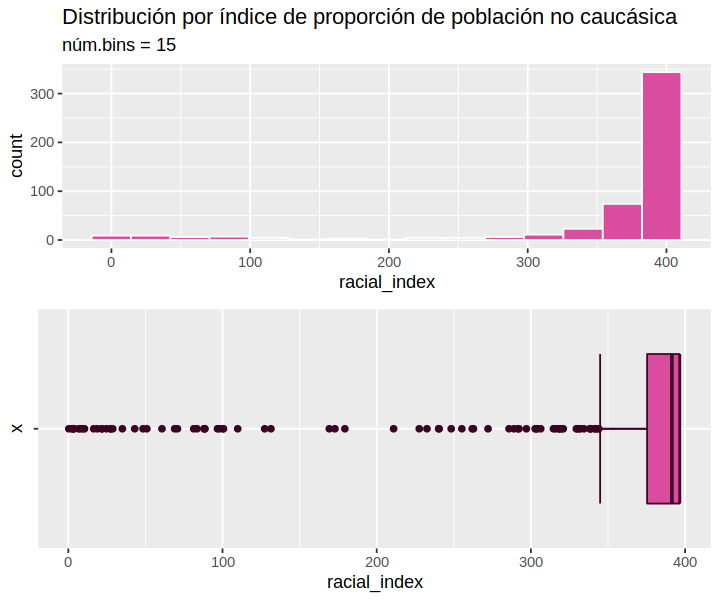

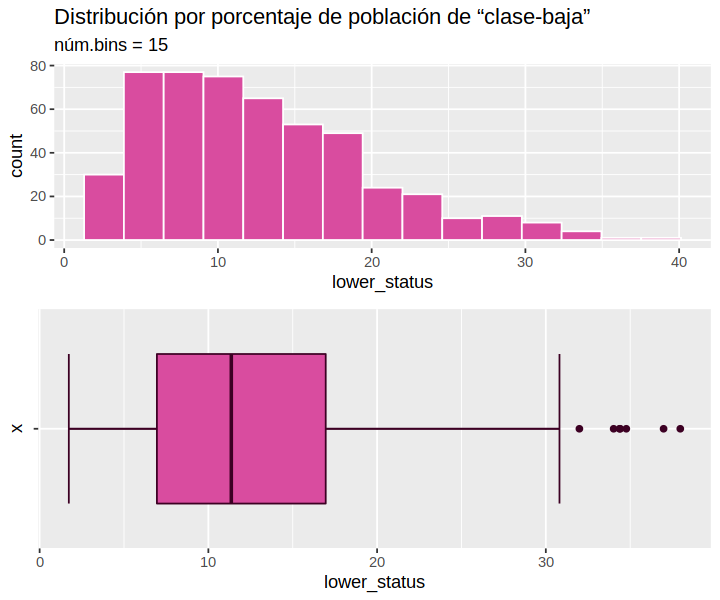

In [39]:
options(repr.plot.width = 6, repr.plot.height = 5)

# crime_index
p1 <- ggplot(boston_data, aes(x = crime_index)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por índice de criminalidad de la zona",
      subtitle = "núm.bins = 15", x = "crime_index")
b1 <- ggplot(data = boston_data, aes(x = "", y = crime_index)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p1,b1)
# urban_ratio
p2 <- ggplot(boston_data, aes(x = urban_ratio)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por ratio de zona urbana residencial",
      subtitle = "núm.bins = 15", x = "urban_ratio")
b2 <- ggplot(data = boston_data, aes(x = "", y = urban_ratio)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p2,b2)

# industry_ratio
p3 <- ggplot(boston_data, aes(x = industry_ratio)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por ratio de industria de la zona",
      subtitle = "núm.bins = 15", x = "industry_ratio")
b3 <- ggplot(data = boston_data, aes(x = "", y = industry_ratio)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p3,b3)

# nox_concentration
p4 <- ggplot(boston_data, aes(x = nox_concentration)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por concentración de óxido nitroso en la zona",
      subtitle = "núm.bins = 15", x = "nox_concentration")
b4 <- ggplot(data = boston_data, aes(x = "", y = nox_concentration)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p4,b4)

# rooms_per_dwelling
p5 <- ggplot(boston_data, aes(x = rooms_per_dwelling)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por número de habitaciones medio por vivienda",
      subtitle = "núm.bins = 15", x = "rooms_per_dwelling")
b5 <- ggplot(data = boston_data, aes(x = "", y = rooms_per_dwelling)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p5,b5)

# dwelling_age
p6 <- ggplot(boston_data, aes(x = dwelling_age)) +
       geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
       labs(title = "Distribución por 'edad' media de la vivienda",
       subtitle = "núm.bins = 15", x = "dwelling_age")
b6 <- ggplot(data = boston_data, aes(x = "", y = dwelling_age)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p6,b6)

# dwelling_dist
p7 <- ggplot(boston_data, aes(x = dwelling_dist)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por distancia media ponderada con los centros urbanos de la ciudad",
      subtitle = "núm.bins = 15", x = "dwelling_dist")
b7 <- ggplot(data = boston_data, aes(x = "", y = dwelling_dist)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p7,b7)

# highway_index
p8 <- ggplot(boston_data, aes(x = highway_index)) +
      geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
      labs(title = "Distribución por índice de accesibilidad sobre autopistas cercanas",
      subtitle = "núm.bins = 15", x = "highway_index")
b8 <- ggplot(data = boston_data, aes(x = "", y = highway_index)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p8,b8)

# tax_ratio
p9 <- ggplot(boston_data, aes(x = tax_ratio)) +
    geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
    labs(title = "Distribución por índice de tasas por cada 10000usd",
    subtitle = "núm.bins = 15", x = "tax_ratio")
b9 <- ggplot(data = boston_data, aes(x = "", y = tax_ratio)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p9,b9)

# teacher_ratio
p10 <- ggplot(boston_data, aes(x = teacher_ratio)) +
    geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
    labs(title = "Distribución por ratio de alumno por profesor",
    subtitle = "núm.bins = 15", x = "teacher_ratio")
b10 <- ggplot(data = boston_data, aes(x = "", y = teacher_ratio)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p10,b10)

# racial_index
p11 <- ggplot(boston_data, aes(x = racial_index)) +
    geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
    labs(title = "Distribución por índice de proporción de población no caucásica",
    subtitle = "núm.bins = 15", x = "racial_index")
b11 <- ggplot(data = boston_data, aes(x = "", y = racial_index)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p11,b11)

# lower_status
p12<- ggplot(boston_data, aes(x = lower_status)) +
    geom_histogram(bins = 15, fill = "#d94c9f", color = "white") +
    labs(title = "Distribución por porcentaje de población de “clase-baja”",
    subtitle = "núm.bins = 15", x = "lower_status")
b12 <- ggplot(data = boston_data, aes(x = "", y = lower_status)) +
       stat_boxplot(geom = "errorbar" ,color = "#3c0023") +
       geom_boxplot(fill = "#d94c9f",color = "#3c0023") +
       coord_flip()
grid.arrange(p12,b12)


- Observamos, tanto en los histogramas como en los boxplots, que la mayoría de variables explicativas presentan outliers.
- Los outliers pueden afectar a los resultados de un modelo de regresión lineal y deben tratarse antes de construirlo.
- No obstante, en este caso los obviaremos y no los trataremos/eliminaremos. Lo tendremos en cuenta a la hora de discutir los resultados y extraer conclusiones.

### Gráficos de dispersión

- Graficamos la relación de cada una de las variables explicativas con la variable objetivo. 

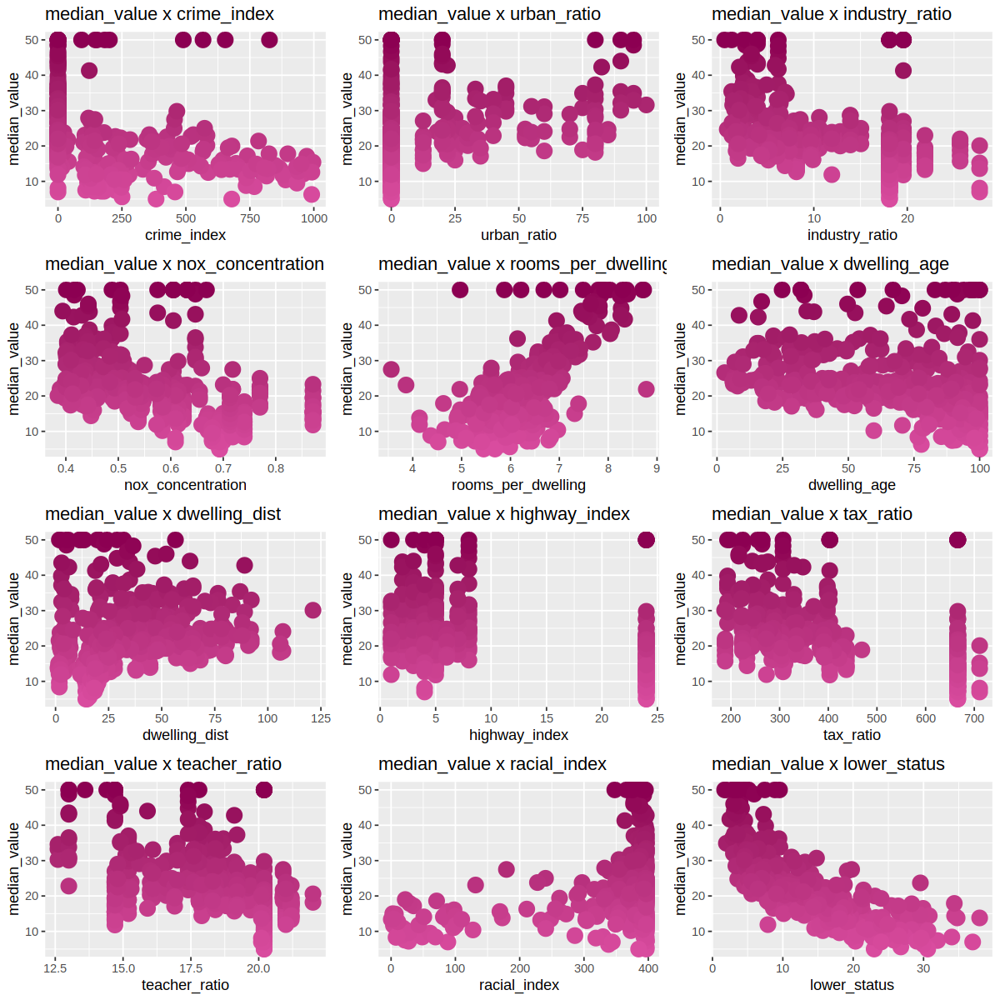

In [51]:
#crime_index
a <- ggplot(boston_data, aes(x = crime_index, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x crime_index ")

#urban_ratio
b <- ggplot(boston_data, aes(x = urban_ratio, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x urban_ratio ")

#industry_ratio
c <- ggplot(boston_data, aes(x = industry_ratio, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x industry_ratio ")

#crime_index
a <- ggplot(boston_data, aes(x = crime_index, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x crime_index ")

#urban_ratio
b <- ggplot(boston_data, aes(x = urban_ratio, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x urban_ratio ")

#industry_ratio
c <- ggplot(boston_data, aes(x = industry_ratio, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x industry_ratio ")

#nox_concentration
d <- ggplot(boston_data, aes(x = nox_concentration, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x nox_concentration ")

#rooms_per_dwelling
e <- ggplot(boston_data, aes(x = rooms_per_dwelling, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x rooms_per_dwelling ")

#dwelling_age
f <- ggplot(boston_data, aes(x = dwelling_age, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x dwelling_age ")

#dwelling_dist
g <- ggplot(boston_data, aes(x = dwelling_dist, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x dwelling_dist ")

#highway_index
h <- ggplot(boston_data, aes(x = highway_index, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x highway_index ")

#tax_ratio
i <- ggplot(boston_data, aes(x = tax_ratio, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x tax_ratio ")

#teacher_ratio
j <- ggplot(boston_data, aes(x = teacher_ratio, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x teacher_ratio ")

#racial_index
k <- ggplot(boston_data, aes(x = racial_index, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x racial_index ")
#lower_status                            
l <- ggplot(boston_data, aes(x = lower_status, y = median_value, color = median_value)) +
   geom_point(size = 5, show.legend = FALSE) +
   scale_color_gradient(low = "#d94c9f", high = "#8c0052") +
   labs(title = "median_value x lower_status ")

grid.arrange(a,b,c,d,e,f,g,h,i,j,k,l)

- Esto nos puede ayudar a tener una idea de la relación entre cada variable explicativa y la variable objetivo.
- No obstante, solo con esto no podemos extraer mucha más información relevante para poder construir nuestro modelo. 

## Correlation Analysis

- Primero haremos un análisis de correlaciones para saber como conviven las variables.
- Luego, haremos el PCA para limpiar las variables y ver con qué variables nos quedamos.

In [41]:
# nombre columnas
colnames(boston_data)

[1] "crime_index"        "urban_ratio"        "industry_ratio"    
 [4] "c_river_variable"   "nox_concentration"  "rooms_per_dwelling"
 [7] "dwelling_age"       "dwelling_dist"      "highway_index"     
[10] "tax_ratio"          "teacher_ratio"      "racial_index"      
[13] "lower_status"       "median_value"

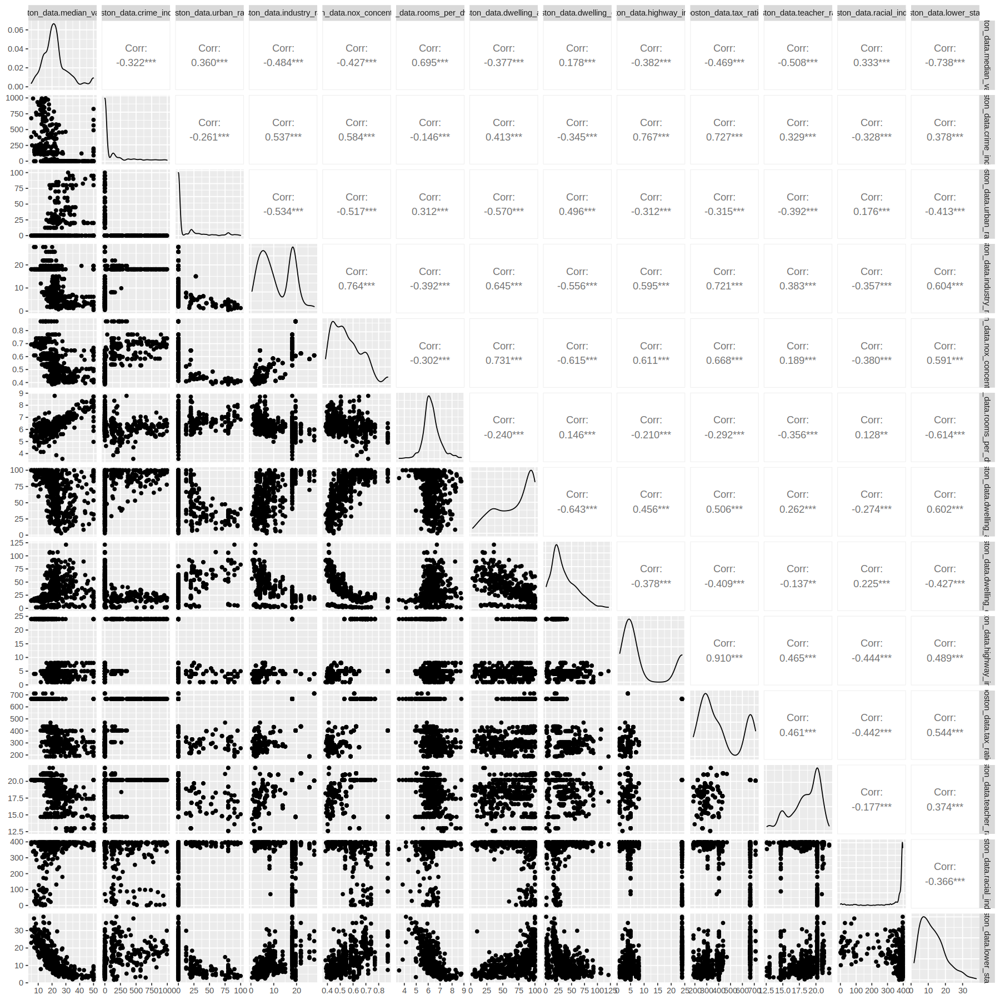

In [95]:
options(repr.plot.width = 15, repr.plot.height = 15)

boston_data_key = data.frame(boston_data$median_value # target
                            ,boston_data$crime_index
                            ,boston_data$urban_ratio
                            ,boston_data$industry_ratio
                            ,boston_data$nox_concentration
                            ,boston_data$rooms_per_dwelling
                            ,boston_data$dwelling_age
                            ,boston_data$dwelling_dist
                            ,boston_data$highway_index
                            ,boston_data$tax_ratio
                            ,boston_data$teacher_ratio
                            ,boston_data$racial_index
                            ,boston_data$lower_status
                            )
ggpairs(boston_data_key)

Variables más correlacionadas con median_value:
- lower_status: -0.738
- rooms_per_dwelling: 0.695
- teacher_ratio: -0.508


## PCA

- Obtenemos tantas componentes como variables tengamos.
- Sirve para empezar a limpiar variables. 
- Posteriormente, con las variables que nos quedemos, volvemos a hacer correlaciones para ver cuáles son las que más correlacionan con median_value, y también para ver como se comportan entre ellas, ya que no queremos poner información redundante dentro del modelo. Eso también ayuda a limpiar. 


- acp = princomp(data_macro_cor,cor=TRUE)
    - Tomamos como referencia correlaciones porque es muy importante que cuando tengamos diferentes unidades una no pese más que la otra.
    - Si el objetivo es analizar las relaciones entre variables, princomp puede ser más apropiado. 
    - Si el objetivo es analizar los patrones en las variables, prcomp puede ser más apropiado.


In [96]:
boston_data_cor = data.frame(
                             boston_data$crime_index
                            ,boston_data$urban_ratio
                            ,boston_data$industry_ratio
                            ,boston_data$nox_concentration
                            ,boston_data$rooms_per_dwelling
                            ,boston_data$dwelling_age
                            ,boston_data$dwelling_dist
                            ,boston_data$highway_index
                            ,boston_data$tax_ratio
                            ,boston_data$teacher_ratio
                            ,boston_data$racial_index
                            ,boston_data$lower_status
                            )
# matriz de correlación 
round(cor(boston_data_cor),2)

# PCA
acp = princomp(boston_data_cor,cor=TRUE)
# resumen del PCA
summary(acp)

# sd
print('desviación estandard componente1:')
sd(predict(acp)[,1:1])

# varianza
print('varianza componente1:')
var(predict(acp)[,1:1])

,boston_data.crime_index,boston_data.urban_ratio,boston_data.industry_ratio,boston_data.nox_concentration,boston_data.rooms_per_dwelling,boston_data.dwelling_age,boston_data.dwelling_dist,boston_data.highway_index,boston_data.tax_ratio,boston_data.teacher_ratio,boston_data.racial_index,boston_data.lower_status
boston_data.crime_index,1.00,-0.26,0.54,0.58,-0.15,0.41,-0.35,0.77,0.73,0.33,-0.33,0.38
boston_data.urban_ratio,-0.26,1.00,-0.53,-0.52,0.31,-0.57,0.50,-0.31,-0.31,-0.39,0.18,-0.41
boston_data.industry_ratio,0.54,-0.53,1.00,0.76,-0.39,0.64,-0.56,0.60,0.72,0.38,-0.36,0.60
boston_data.nox_concentration,0.58,-0.52,0.76,1.00,-0.30,0.73,-0.62,0.61,0.67,0.19,-0.38,0.59
boston_data.rooms_per_dwelling,-0.15,0.31,-0.39,-0.30,1.00,-0.24,0.15,-0.21,-0.29,-0.36,0.13,-0.61
boston_data.dwelling_age,0.41,-0.57,0.64,0.73,-0.24,1.00,-0.64,0.46,0.51,0.26,-0.27,0.60
boston_data.dwelling_dist,-0.35,0.50,-0.56,-0.62,0.15,-0.64,1.00,-0.38,-0.41,-0.14,0.22,-0.43
boston_data.highway_index,0.77,-0.31,0.60,0.61,-0.21,0.46,-0.38,1.00,0.91,0.46,-0.44,0.49
boston_data.tax_ratio,0.73,-0.31,0.72,0.67,-0.29,0.51,-0.41,0.91,1.00,0.46,-0.44,0.54
boston_data.teacher_ratio,0.33,-0.39,0.38,0.19,-0.36,0.26,-0.14,0.46,0.46,1.00,-0.18,0.37


Importance of components:
                          Comp.1    Comp.2    Comp.3     Comp.4     Comp.5
Standard deviation     2.4558609 1.1671344 1.1032662 0.91899327 0.83360592
Proportion of Variance 0.5026044 0.1135169 0.1014330 0.07037905 0.05790824
Cumulative Proportion  0.5026044 0.6161213 0.7175543 0.78793334 0.84584158
                           Comp.6     Comp.7     Comp.8     Comp.9    Comp.10
Standard deviation     0.65379430 0.61044283 0.58702929 0.50530319 0.46408767
Proportion of Variance 0.03562058 0.03105337 0.02871695 0.02127761 0.01794811
Cumulative Proportion  0.88146216 0.91251553 0.94123248 0.96251009 0.98045820
                          Comp.11     Comp.12
Standard deviation     0.41331156 0.252339242
Proportion of Variance 0.01423554 0.005306258
Cumulative Proportion  0.99469374 1.000000000

[1] "desviación estandard componente1:"


[1] 2.458291

[1] "varianza componente1:"


[1] 6.043196

- Obtenemos un total de 12 componentes (tantas como variables tengo sin contar la categórica: c_river_variable).

- La 1ª componente es la que más varianza nos va a explicar: ya lo resume, ya hace la combinación lineal entre nuestras variables que explique todas esas variables que le hemos metido. 

- Miramos la Proportion of Variance (una medida de la cantidad de variación en los datos originales que es capturada por cada uno de los componentes principales) de la componente 1 y 2: 0.50 + 0.11 = 0.61. Es decir, la comp1 y 2 nos explican el 61% de la variación de los datos. 

- Añadimos la componente 3: 0.50+0.11+0.10 = 0.71. La comp 1, 2 y 3 nos explican el 71% de la variación de los datos.

- Con un 70%, para empezar a generar un modelo lineal y comenzar a limpiar variables ya nos sirve. Si luego generamos un modelo lineal con una R2 suficiente, nos podremos dar por satisfechos. 

In [65]:
# A través de esta función tendriamos las puntuaciones en las componentes principales
# Nos es útil para comparar  como para usar estas componentes sustituyendolas por las variables originales
predict(acp)
# acp$scores #otra forma de llamarlos

Comp.1,Comp.2,Comp.3,Comp.4,Comp.5,Comp.6,Comp.7,Comp.8,Comp.9,Comp.10,Comp.11,Comp.12
-1.77419933,-0.83641824,1.68468208,-0.19541211,0.2138119,-0.33269184,1.02809790,0.54292080,-0.07622941,-0.63732934,-0.095811183,0.398234753
-1.53258864,-0.88836251,0.01191733,0.32787045,-0.3920731,0.36687798,-0.61783162,0.40406585,0.11523366,-0.16829276,0.457722105,-0.045216899
-2.14460225,-0.21871316,0.68492119,0.83794301,-0.8377848,0.55502178,-0.42680163,0.04653939,0.07335502,0.10785407,0.164420758,-0.001502318
-2.64321334,0.11629257,-0.03394848,0.99080683,-0.9848400,0.70735944,-0.32061031,0.42992299,-0.04039999,-0.12246952,-0.245474330,0.010141487
-2.49099217,0.02214451,0.08187553,0.96481767,-0.9874673,0.48594354,-0.65139696,0.53876359,-0.09253187,0.03911216,-0.203515154,0.021600844
-2.25000276,-0.32376460,-0.48200767,0.65955855,-0.7103746,0.64024994,-0.39557875,0.64046957,0.03968374,-0.45506797,-0.001695199,-0.029002032
-1.40779172,-0.60159194,0.06567279,-0.81174227,0.6847666,0.79393801,-0.47117578,0.29934276,-0.40757723,-0.11780122,0.316118263,-0.063940594
-0.87958375,-0.97473426,0.15689795,-1.03158088,0.7512281,0.27021966,-1.50731525,0.65699245,-0.48300174,0.09096977,0.570222152,-0.057226917
-0.22076811,-1.51513561,-0.66811073,-1.83388274,1.1170522,-0.06475711,-1.76335092,1.12560725,-0.69015210,0.62623484,0.532905610,-0.043086329
-1.08887060,-0.77835128,-0.11276318,-1.10455894,0.7197244,0.63572032,-1.32613639,0.54199075,-0.44056062,-0.03493083,0.510211895,-0.070507523


- La función predict() en R se utiliza para hacer predicciones basadas en un modelo. 

- En el caso, la función predict() se aplica a un objeto PCA obtenido de la función princomp(), lo que significa que devolverá las puntuaciones de componentes principales predichas para las observaciones del conjunto de datos original.

- Las puntuaciones de los componentes principales son las coordenadas de las observaciones en el nuevo sistema de coordenadas definido por los componentes principales. 

- La puntuación de la primera componente principal es la proyección de cada observación sobre la primera componente principal, la puntuación de la segunda componente principal es la proyección de cada observación sobre la segunda componente principal, y así sucesivamente.

- Es decir, para cada una de mis observaciones, que valor tendría esa nueva variable (esa componente), para cada una las componentes. A partir de esto luego podremos dibujarlo en los ejes de coordenadas mediante el biplot(). Esto nos ayudará a saber qué variables son las que mayor peso tienen en la componente 1 o en la componente 2. 

In [194]:
loadings(acp)


Loadings:
                               Comp.1 Comp.2 Comp.3 Comp.4 Comp.5 Comp.6 Comp.7
boston_data.crime_index         0.290  0.404         0.166  0.246  0.215       
boston_data.urban_ratio        -0.251  0.406        -0.348  0.399 -0.556       
boston_data.industry_ratio      0.350                              0.194       
boston_data.nox_concentration   0.347         0.254 -0.110  0.168  0.239 -0.146
boston_data.rooms_per_dwelling -0.186  0.306  0.596  0.291 -0.296 -0.184 -0.332
boston_data.dwelling_age        0.314 -0.279  0.249               -0.253 -0.565
boston_data.dwelling_dist      -0.265  0.283 -0.402                0.473 -0.674
boston_data.highway_index       0.329  0.415         0.110                     
boston_data.tax_ratio           0.347  0.342                0.139              
boston_data.teacher_ratio       0.207        -0.530  0.492 -0.373 -0.350       
boston_data.racial_index       -0.202 -0.264         0.616  0.687              
boston_data.lower_status     

- Loadings son los pesos: nos dice qué variables son las que realmente están aportando mayor información en esta componente. Los pesos son los coeficientes que describen la combinación lineal de las variables originales que componen cada componente principal.

- Nos quedamos de la componente1 con el industry_ratio (0.350) que es la que mayor peso tiene, de la componente2 con el highway_index (0.415) y de la componente 3 rooms_per_dwelling (0.596). 
- Seleccionaremos también lower_status (0.307) y teacher_ratio (-0.530) ya que pueden ser interesantes. 

- (Se miran tanto las positivas como las negativas, las que tengan más peso ya sea en + o en -).

- Ya hemos hecho una criba de variables.

-  Queremos saber qué variables contribuyen más a esas componentes principales. Con solo estas, ya vamos a tener una mínima explicabilidad. ¿Esto nos será suficiente para tener un buen modelo? Vamos a verlo. 





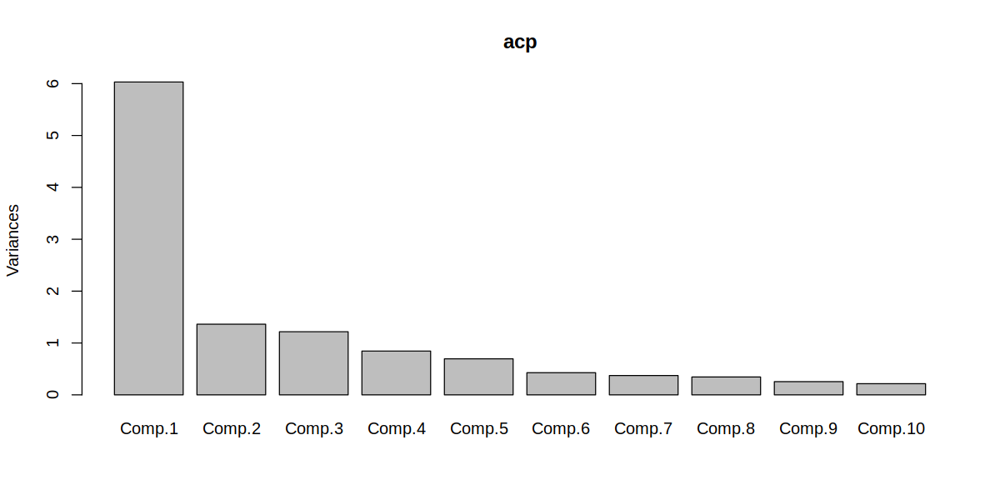

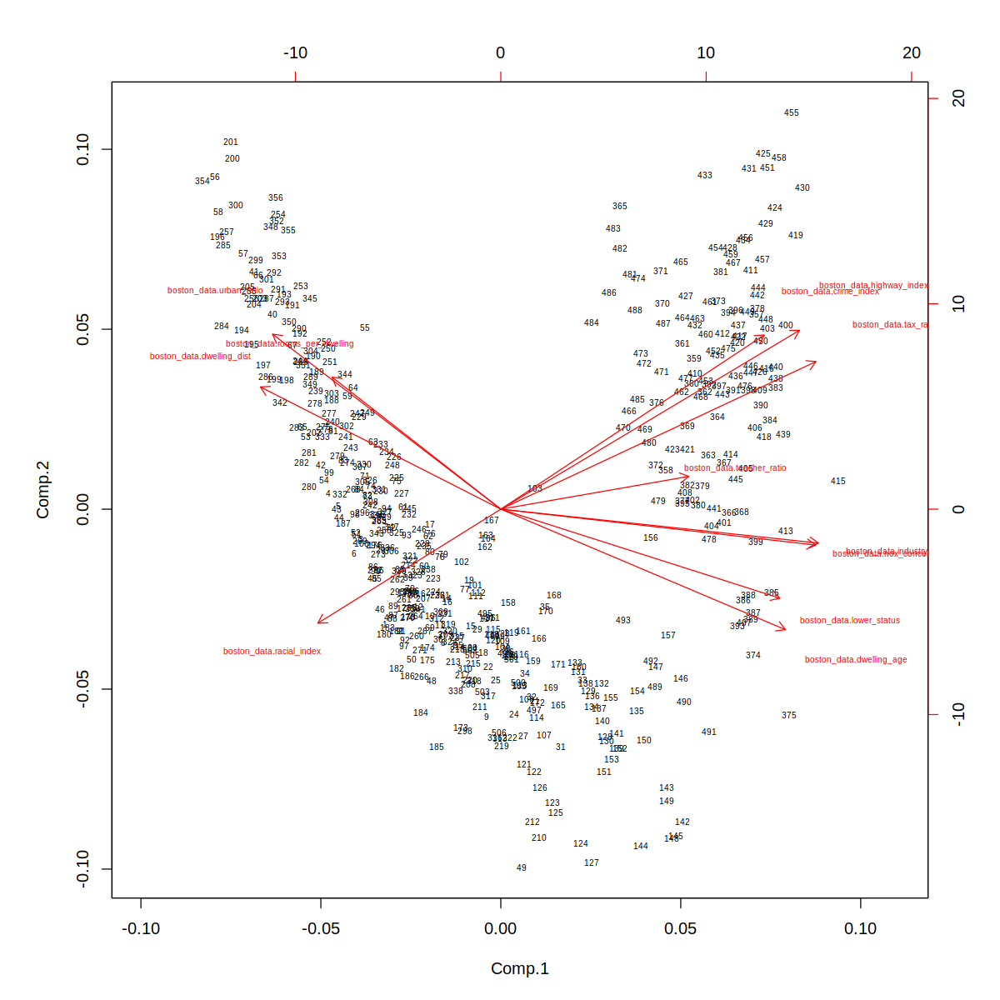

In [127]:
options(repr.plot.width = 10, repr.plot.height = 5)
plot(acp)

options(repr.plot.width = 10, repr.plot.height = 10)
biplot(acp, cex=0.5)

Barplot
- La suma de las varianzas tiene que sumar 12: entre las 3 primeras componentes ya vemos que casi todo queda explicado, las últimas son residuales. 
 
Biplot:
- Dibujamos las variables en los ejes. 
- Gráfico de dispersión de las puntuaciones de los componentes principales que incluye los pesos (o coeficientes) de las variables originales en los componentes principales. Las cargas se representan mediante flechas que indican la dirección y la magnitud de la contribución de cada variable a los componentes principales. La longitud de la flecha corresponde a la magnitud de la carga, y la dirección de la flecha indica la dirección de la carga.
- Qué nuevo valor tienen la comp1 y la comp2 para dibujarlo en el eje de coordenadas. 
- Podemos obervar si una variable está más relacionada con la comp1 o la comp2.
- Es una representación extra que podemos hacer para visualizarlo. 

### Matriz de componentes

In [129]:
mcomponentes = cor(boston_data_cor,predict(acp)[,1:3]) # Matriz de componentes
mcomponentes


apply(mcomponentes*mcomponentes,1,sum)

,Comp.1,Comp.2,Comp.3
boston_data.crime_index,0.7125499,0.47114263,0.09409669
boston_data.urban_ratio,-0.6174346,0.47346560,-0.01351245
boston_data.industry_ratio,0.8592487,-0.09174701,0.04284603
boston_data.nox_concentration,0.8519576,-0.09718545,0.28044297
boston_data.rooms_per_dwelling,-0.4565183,0.35724948,0.65773896
boston_data.dwelling_age,0.7701133,-0.32607730,0.27500572
boston_data.dwelling_dist,-0.6505668,0.33069181,-0.44306401
boston_data.highway_index,0.8080864,0.48406645,-0.02695591
boston_data.tax_ratio,0.8525627,0.39935721,-0.04654563
boston_data.teacher_ratio,0.5085209,0.08870757,-0.58456270


boston_data.crime_index        boston_data.urban_ratio 
                     0.7385570                      0.6055778 
    boston_data.industry_ratio  boston_data.nox_concentration 
                     0.7485617                      0.8139250 
boston_data.rooms_per_dwelling       boston_data.dwelling_age 
                     0.7686567                      0.7750291 
     boston_data.dwelling_dist      boston_data.highway_index 
                     0.7289000                      0.8880505 
         boston_data.tax_ratio      boston_data.teacher_ratio 
                     0.8885158                      0.6081761 
      boston_data.racial_index       boston_data.lower_status 
                     0.3414907                      0.7052112

- Los pesos de los componentes muestran las relaciones lineales entre cada variable original y los 3 componentes. Los valores positivos indican una relación positiva entre la variable original y el componente, mientras que los valores negativos indican una relación negativa.

- Podemos observar que varias variables tienen pesos elevados en el primer componente (Comp.1), como industry_ratio y lower_status. Esto sugiere que estas variables impulsan el primer componente, que podría captar algún aspecto importante de la variación de los datos.

- El segundo componente (Comp.2) tiene pesos positivos para la variable highway_index. Esto sugiere que este componente podría estar captando alguna relación entre estas variables en los datos.

- El tercer componente (Comp.3) tiene pesos positivos elevados para rooms_per_dwelling y teacher_ratio. Esto sugiere que este componente podría estar capturando alguna relación entre estas variables en los datos.

- Por tanto, los resultados de este PCA sugieren que existen varias relaciones subyacentes en los datos que podrían ser captadas por estos 3 componentes.

In [135]:
# highway_index
0.8080864^2 + (0.48406645)^2 + (-0.02695591)^2

[1] 0.8880506

- Por ejemplo. la comp1, la comp2 y la comp3 me están explicando el 88% de la variación del highway_index. Me está conservando mucha información. Estas nuevas variables abstractas me están explicando mucho. 
- Por tanto, un 88% de la varianza de highway_index viene explicada por la componente 1, 2 y 3.

- Para las otras variables de interés:

In [136]:
# rooms_per_dwelling
(-0.4565183)^2 + (0.35724948)^2 + (0.65773896)^2

[1] 0.7686567

In [134]:
# industry_ratio
0.8592487^2 + (-0.09174701)^2 + (0.04284603)^2

[1] 0.7485616

In [284]:
# lower_status
(0.7549382)^2 + (-0.24090850)^2 + (-0.27792548)^2

[1] 0.7052112

In [285]:
# teacher_ratio	
(0.5085209)^2 + (0.08870757)^2 + (-0.58456270)^2

[1] 0.6081761

## ANOVA para c_river_variable

- Como tenemos una variable categórica (c_river_variable), esta no se puede añadir ni al PCA ni al análisis de correlación.
- Entonces debemos hacer una ANOVA para ver como esta variable está relacionada con la variable objetivo (median_value).


Recordemos que c_river_variable:
- 1 si la zona colinda con un río
- 0 si no colinda con un río

In [148]:
# subset con la variable objetivo y la variable categórica
boston_aov_df <- boston_data[,c("median_value", "c_river_variable")]

In [149]:
head(boston_aov_df)

,median_value,c_river_variable
,<dbl>,<int>
1,24.0,0
2,21.6,0
3,34.7,0
4,33.4,0
5,36.2,0
6,28.7,0


In [150]:
dim(boston_aov_df)

[1] 506   2

In [151]:
# convertimos c_river_variable de tipo de dato numérico a categórico
boston_aov_df$c_river_variable <- as.factor(boston_aov_df$c_river_variable)

In [153]:
str(boston_aov_df)

'data.frame':	506 obs. of  2 variables:
 $ median_value    : num  24 21.6 34.7 33.4 36.2 28.7 22.9 27.1 16.5 18.9 ...
 $ c_river_variable: Factor w/ 2 levels "0","1": 1 1 1 1 1 1 1 1 1 1 ...


- Hemos convertido c_river_variable a Factor, lo cual es una buena práctica ya que es una variable categórica.

In [176]:
# visión general del df
summary(boston_aov_df)

  median_value   c_river_variable
 Min.   : 5.00   0:471           
 1st Qu.:17.02   1: 35           
 Median :21.20                   
 Mean   :22.53                   
 3rd Qu.:25.00                   
 Max.   :50.00                   

### Primeras suposiciones

In [157]:
boston_aov_df %>% # pasamos los datos en el objeto boston_aov_df como entrada a la siguiente operación
    group_by(c_river_variable) %>%  # agrupamos los datos en el objeto boston_aov_df por la variable c_river_variable  
    # calculamos la media y la desviación estándar de la variable median_value para cada grupo de c_river_variable  
    summarize(media = mean(median_value), desv = sd(median_value))

c_river_variable,media,desv
<fct>,<dbl>,<dbl>
0,22.09384,8.831362
1,28.44000,11.816643


- Parece que los dos grupos tienen valores diferentes de media y desviación típica para la variable median_value.

- Basándonos únicamente en este análisis, no podemos afirmar que el valor medio del precio de la vivienda se vea afectado por si la zona colinda con un río o no. 

In [159]:
# para poder establecer el límite en x (xlim) miramos el valor mínimo y máximo: 
range(boston_aov_df$median_value)

[1]  5 50

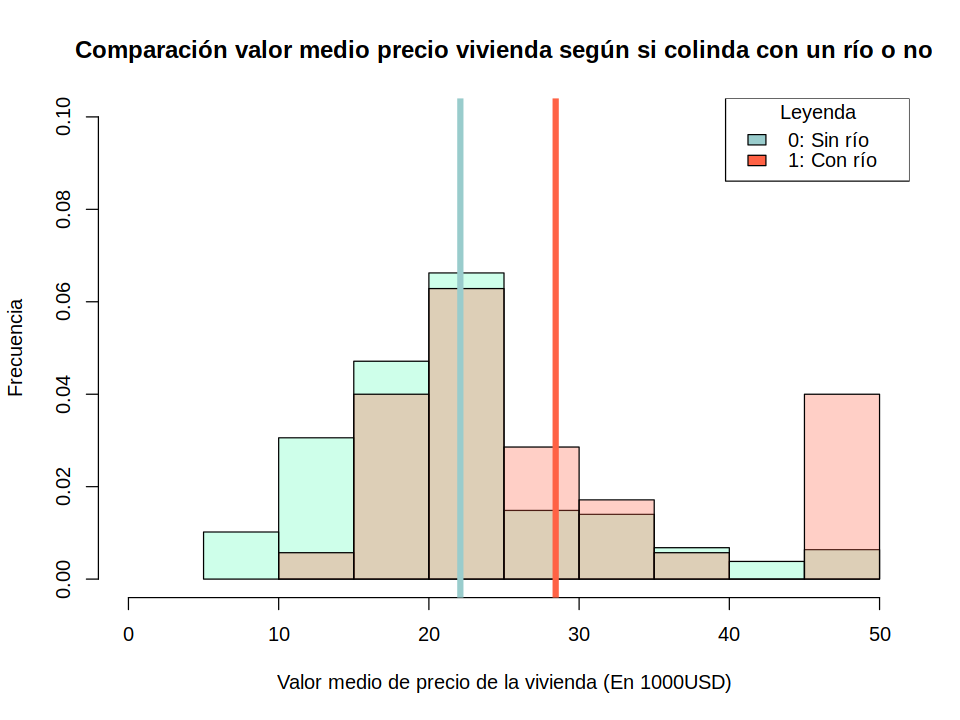

In [286]:
options(repr.plot.width = 8, repr.plot.height = 6)

hist(subset(boston_aov_df,c_river_variable=='0')[,'median_value'],
    col = rgb(0.369,1,0.737,0.3),
    main = 'Comparación valor medio precio vivienda según si colinda con un río o no',  
    freq = F,
    ylim = c(0,0.1),
    xlim = c(0, 50),
    xlab='Valor medio de precio de la vivienda (En 1000USD)',
    ylab = 'Frecuencia') #verde
hist(subset(boston_aov_df,c_river_variable=='1')[,'median_value'],
    col = rgb(1,0.384,0.272,0.3),
    add = T,
    ylim = c(0,0.1),
    xlim = c(0, 50),
    freq = F) #naranja




abline(v = mean(subset(boston_aov_df,c_river_variable=='0')[,'median_value'])
       , col = rgb(0.6,0.8,0.8,1), lwd = 5)
abline(v = mean(subset(boston_aov_df,c_river_variable=='1')[,'median_value'])
       , col = rgb(1,0.384,0.272,1), lwd = 5) 


legend(x = "topright", legend = c("0: Sin río", "1: Con río"), fill = c(rgb(0.6,0.8,0.8,1), rgb(1,0.384,0.272,1),
       rgb(0,0,1,1)), title = "Leyenda")


- El histograma muestra la distribución de los valores medios del precio de la vivienda (en 1000USD) para zonas que colindan con un río y zonas sin río. 

- Cada línea representa el valor medio del precio de la vivienda (En 1000USD) para cada grupo.

- En un principio, no parece ser que los datos sigan una distribución normal, y se pueden observar valores atípicos en el grupo 0 (sin río).

- Parece ser que en las zonas con río, el valor medio del precio de la vivienda es más alto. 


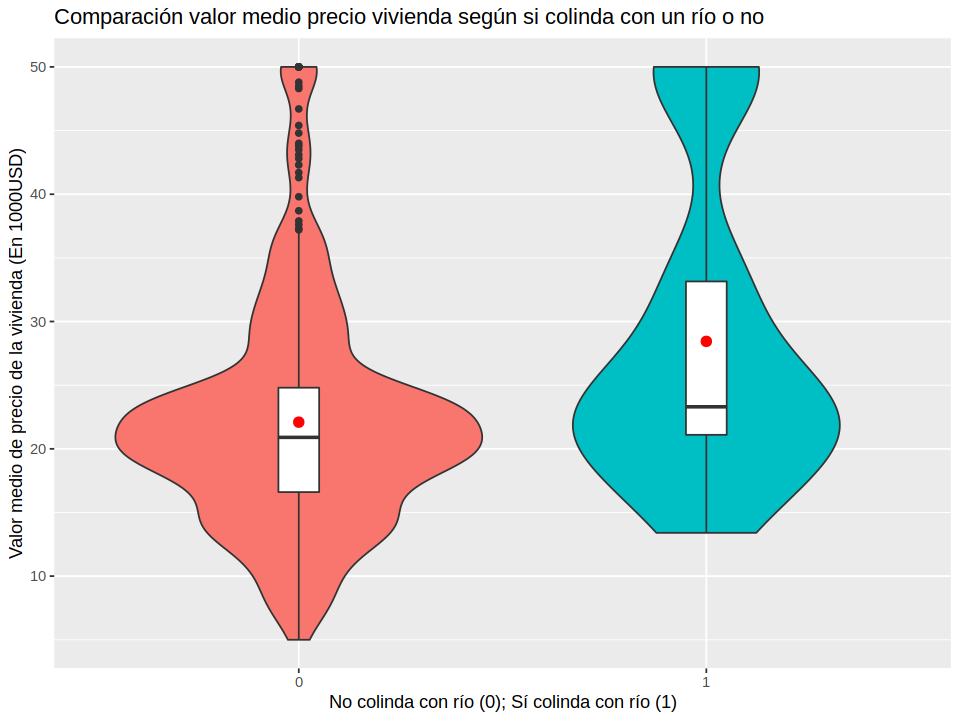

In [287]:
# violin plots
p = ggplot(boston_aov_df, aes(factor(c_river_variable), median_value)) +
    xlab('No colinda con río (0); Sí colinda con río (1)') +
    ylab('Valor medio de precio de la vivienda (En 1000USD)') + 
    ggtitle("Comparación valor medio precio vivienda según si colinda con un río o no" )
p + geom_violin(aes(fill = factor(c_river_variable))) + 
    theme(legend.position="none") +
    geom_boxplot(width=.1) + stat_summary(fun=mean, geom="point", shape=20, size=4, color="red", fill="red")

- Observando el gráfico de violín así como las medias y las desviaciones estándar por categoría parece ser que hay una notable diferencia entre el valor medio del precio de la vivienda de las zonas con río y sin río.

- Podemos observar varios valores atípicos (outliers) en el bigote superior del grupo 0 (sin río).

- Las distribución de los datos no parece una distribución normal, aunque esto lo corroboraremos en el siguiente punto mediante tests de normalidad como el Anderson-Darling test. 

### Comprobación de condiciones 

Comprobamos las condiciones para poder aplicar el test ANOVA.

ANOVA (Analysis of Variance) es una técnica estadística que se utiliza para dos o más grupos para comprobar si existe una diferencia entre sus valores medios [1],[2].

Las suposiciones de ANOVA son:
- La distribución de los datos es normal
- La varianza es constante entre los grupos
- Las observaciones son independientes entre sí


#### Normalidad

- Visualización: Q-Q Plot
- Prueba estadística: se utiliza el test de normalidad de Anderson-Darling ya tenemos más de 50 muestras (0: 471; 1: 35)
    - H0: La variable presenta una distribución normal
    - H1: La variable presenta una distribución no normal
    - p-value > 0.05: No rechazar H0 (normal)
    - p-value < 0.05: Rechazar H0


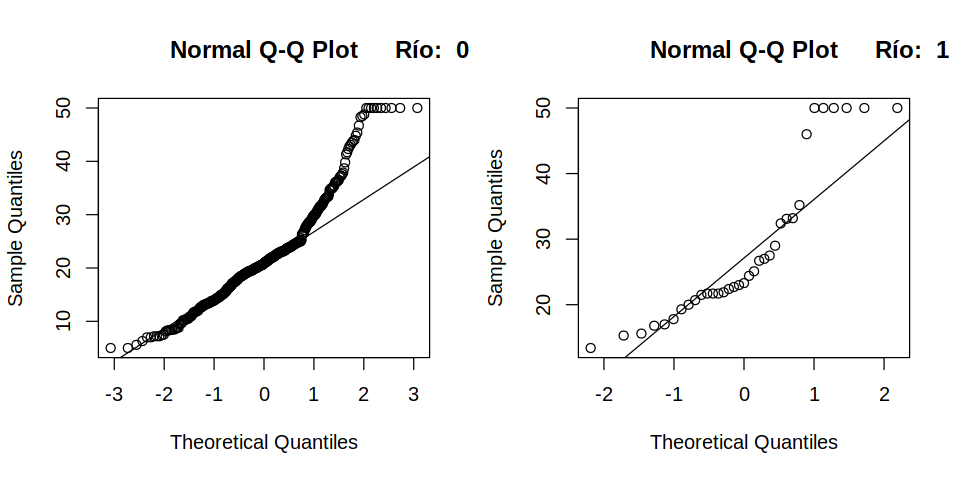

In [180]:
# Create normal probability plots for all regions
options(repr.plot.width = 8, repr.plot.height = 4)
par(mfrow = c(1,2))
for(i in unique(boston_aov_df$c_river_variable)){
  qqnorm(subset(boston_aov_df, c_river_variable == i)[,'median_value'])
  qqline(subset(boston_aov_df, c_river_variable == i)[,'median_value'])
  title(paste("\t\t\t\t\t\tRío: ",i))
}

In [190]:
# Test de Normalidad de Anderson-Darling
for(i in unique(boston_aov_df$c_river_variable)){
    anderson_darling_river<-ad.test(subset(boston_aov_df, c_river_variable == i)[,'median_value'])
    # imprimimos el resultado del Anderson-Darling test según si tienen río o no
    print(anderson_darling_river)
}


	Anderson-Darling normality test

data:  subset(boston_aov_df, c_river_variable == i)[, "median_value"]
A = 9.1015, p-value < 2.2e-16


	Anderson-Darling normality test

data:  subset(boston_aov_df, c_river_variable == i)[, "median_value"]
A = 2.2267, p-value = 9.005e-06



- Observamos que el p-value < 0.05 para ambos grupos. 
- El test de normalidad de Anderson Darling rechaza la hipótesis de normalidad cuando el p-value ≤ 0.05.  
- Fallar la prueba de normalidad permite afirmar con un 95% de confianza que los datos no se ajustan a la distribución normal.

No obstante, aunque los datos NO pasen la prueba de normalidad, es importante comprobar otros supuestos del ANOVA, como la homocedasticidad.

#### Homocedasticidad

Homocedasticidad: las varianzas son iguales en todos los grupos.
-  Bartlett’s test: 
    - Para verificar el supuesto de que las varianzas son iguales en todos los grupos.
    - Compara las varianzas de k muestras, donde k puede ser más de dos muestras [3]. 
    - Los datos deben estar distribuidos normalmente.
    - Hipótesis nula H0: todas las varianzas de las poblaciones son iguales.
    - Hipótesis alternativa H1: al menos dos de ellas difieren.

In [191]:
# Bartlett’s test with one independent variable (c_river_variable):
res_c_river_variable <- bartlett.test(median_value ~ c_river_variable, data = boston_aov_df)
res_c_river_variable


	Bartlett test of homogeneity of variances

data:  median_value by c_river_variable
Bartlett's K-squared = 6.3155, df = 1, p-value = 0.01197


- Podemos observar que el p-value no es superior al nivel de significancia (p-value < 0.05). 

- Por tanto, podemos rechazar la hipótesis nula y podemos concluir que las varianzas entre si la casa colinda con un río o no, no son iguales. 



#### Independencia en las muestras

- La independencia de las muestras se refiere al supuesto de que las observaciones de cada muestra no están influidas por las observaciones de otras muestras.

- Que las muestras sean independientes o no depende del contexto de los datos y de cómo se hayan recogido. 

- Por ejemplo, si los datos se recogieron en distintos barrios de Boston y cada barrio representa una muestra independiente, se puede suponer que las observaciones de cada barrio son independientes de las observaciones de otros barrios.

- Suponemos que las muestras son independientes.

- Después de realizar los supuestos, vemos que no se cumplen los supuestos de normalidad y homocedasticidad.
- Por tanto NO podemos aplicar el test ANOVA.
- Deberemos usar alternativas no-paramétricas, como por ejemplo, el test de Kruskal-Wallis, que no asume la normalidad ni la igualdad de varianzas entre grupos.


## Kruskall - Wallis test

- La prueba de Kruskal-Wallis es un método no paramétrico para testear la hipótesis nula de que las medianas de dos o más grupos son iguales. 
- Puede utilizarse para determinar si el valor medio del precio de la vivienda es significativamente diferente en los dos niveles de c_river_variable (0 y 1).

- Si la prueba de Kruskal-Wallis muestra una diferencia significativa en el median_value entre los dos niveles de c_river_variable, indicaría que la presencia o ausencia de un río tiene un efecto significativo en el valor medio del precio de la vivienda, y podríamos considerar incluir c_river_variable como predictor en el modelo de regresión lineal múltiple.

In [192]:
# Perform the Kruskal-Wallis test
kruskal.test(median_value ~ c_river_variable, data = boston_aov_df)


	Kruskal-Wallis rank sum test

data:  median_value by c_river_variable
Kruskal-Wallis chi-squared = 9.9847, df = 1, p-value = 0.001578


- Como el p-value < 0.05, podemos rechazar la hipótesis nula y concluir que existen pruebas significativas de que las medianas de median_value son diferentes entre los dos niveles de c_river_variable.
- Esto indica que existe una diferencia en los valores medianos de el valor medio del precio de la vivienda en función de la presencia o ausencia de un río.
- Basándose en este resultado, puede ser apropiado considerar la inclusión de c_river_variable como predictor en nuestro modelo de regresión lineal múltiple.

- No obstante, c_river_variable es una variable categórica, y un modelo de regresión lineal múltiple no puede tratar variables categóricas directamente, ya que asume que todos los predictores son variables continuas.

- Para incluir una variable categórica en un modelo de regresión lineal múltiple, es necesario transformarla en un conjunto de variables ficticias o 'dummy variables' (one-hot encoding). 

- También puede ser más apropiado utilizar métodos de regresión alternativos, como la regresión logística o los árboles de decisión, que pueden manejar variables categóricas directamente. 

- Es por ello, que en nuestro caso, no incluiremos c_river_variable como predictor en nuestro modelo de regresión lineal múltiple.

<u>Nota<u>:
    
Si decidiéramos incluir c_river_variable como predictor en nuestro modelo de regresión lineal múltiple, antes deberíamos tener en cuenta otros factores:
    
- Correlación con otros predictores: comprobar si c_river_variable está muy correlacionada con otros predictores del modelo. Si lo está, puede dar lugar a problemas de multicolinealidad y afectar a la interpretación de los coeficientes de regresión.
    
- Relación no lineal con la variable objetivo: si la relación entre c_river_variable y la variable objetivo median_value no es lineal, puede que no sea adecuado añadirla como predictor en un modelo de regresión lineal. 

- Supuestos del modelo: debemos asegurarnos de que se cumplen los supuestos del modelo de regresión lineal múltiple, como la linealidad, la normalidad de los errores, la homocedasticidad y la independencia de los errores.
    
- Ajuste del modelo: comprobar el ajuste del modelo de regresión lineal múltiple. Si el ajuste del modelo es deficiente, podríamos considerar añadir o eliminar predictores o utilizar un método de regresión diferente.

- Interpretación del modelo: tras incluir c_river_variable como predictor, tendríamos que comprobar la interpretación de los coeficientes de regresión. Un coeficiente positivo para c_river_variable indicaría que las casas cercanas a un río tienden a tener valores medios más altos, mientras que un coeficiente negativo indicaría lo contrario.


## Construcción del modelo linear múltiple

### División del dataset en train y test

Cuando empezamos a generar el modelo lo primero que hacemos es dividir el dataset en test y train:


In [197]:
boston_data_ml = boston_data
set.seed(123)
inTrain = createDataPartition(y = boston_data$median_value
                              ,p = 0.6
                              , list = FALSE
                              , times = 1)

data_train  = boston_data_ml[inTrain, ]
data_test = boston_data_ml[-inTrain, ]

- Estos conjuntos de datos se utilizarán para entrenar y testear el modelo de regresión lineal, donde el modelo se ajustará a los datos de entrenamiento y se utilizará para hacer predicciones sobre los datos de prueba. Esto le permitirá evaluar el rendimiento del modelo en datos no observados y asegurarse de que el modelo generaliza bien con nuevos datos.

### Selección de variables predictoras

- Posteriormente al PCA, con las variables que nos hemos quedado, volvemos a hacer correlaciones para ver cuáles son las que más correlacionan con median_value, y también para ver como se comportan entre ellas, ya que no queremos poner información redundante dentro del modelo. Eso también ayuda a limpiar. 

- Cuando ya hemos detectado los predictores que queremos entrar al modelo, debemos confirmar que estos son independientes entre ellos: buscamos si puede haber problemas multicolinealidad.

- Volvemos a generar las correlaciones solo con las variables que nos interesan. 

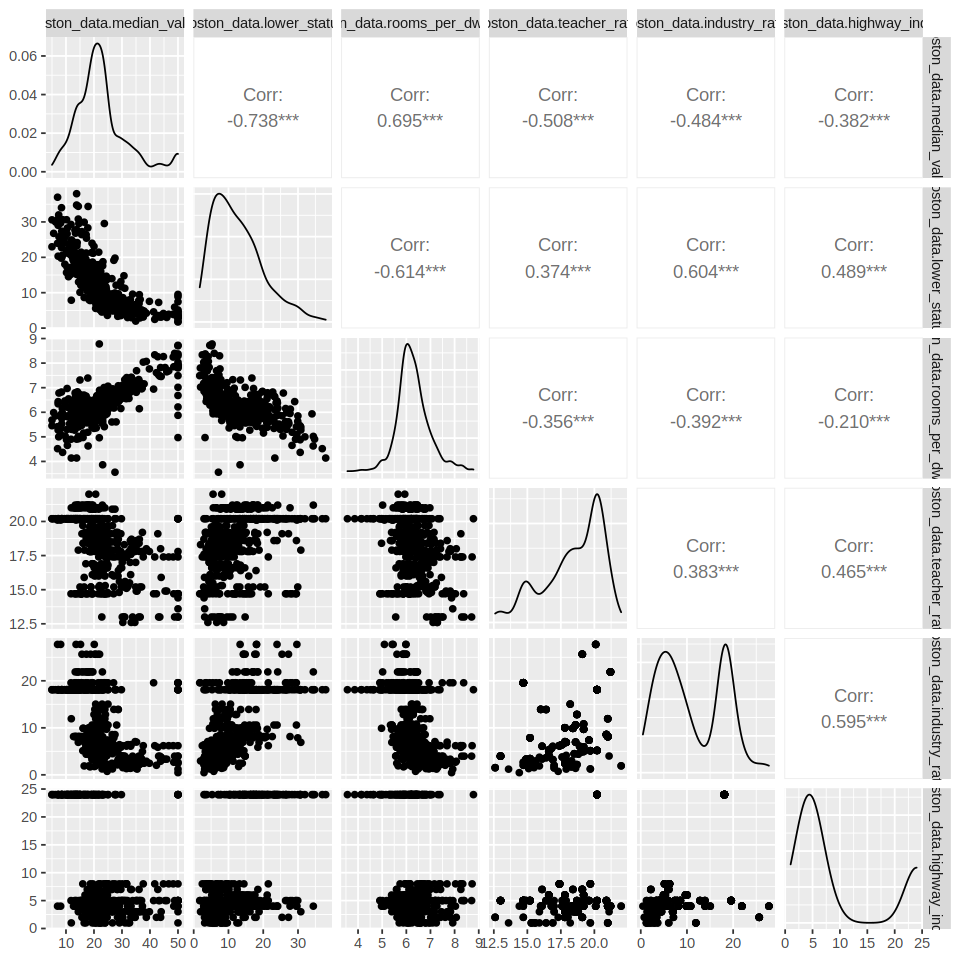

In [196]:
# Variables seleccionadas por PCA:

options(repr.plot.width = 8, repr.plot.height = 8)

boston_data_preml = data.frame(
                             boston_data$median_value, # target variable
                             boston_data$lower_status,                            
                             boston_data$rooms_per_dwelling,
                             boston_data$teacher_ratio,
                             boston_data$industry_ratio,
                            boston_data$highway_index
                            )
ggpairs(boston_data_preml)

- Parece ser que elegir lower_status, rooms_per_dwelling y teacher_ratio puede ser una buena opción. 
- A continuación comprobaremos que efectivamente no presenten problemas de  multicolinealidad.

Para ello utilizaremos el VIF: 
- El valor VIF (factor de inflación de la varianza) mide el grado de multicolinealidad entre los predictores del modelo de regresión [4]. 
- Un valor VIF cercano a 1 indica que existe poca o ninguna multicolinealidad entre un predictor y los demás predictores del modelo.
- Un valor entre 1 y 5 indica una correlación moderada entre un predictor y los otros predictores del modelo, pero no suele ser lo suficientemente grave.
- Un valor superior a 5 indica una correlación potencialmente grave entre un determinado predictor y otros predictores del modelo. En este caso, es probable que los coefficient estimates y los p-values de los resultados de la regresión no sean fiables.


In [ ]:
# Fit a multiple linear regression model 
model <- lm(median_value ~ ., data = data_train)

# Calculate the VIF for each predictor in the model
VIF(model)

crime_index        urban_ratio     industry_ratio   c_river_variable 
          2.766733           2.006711           3.857423           1.153907 
 nox_concentration rooms_per_dwelling       dwelling_age      dwelling_dist 
          4.443815           1.903808           2.950063           2.032943 
     highway_index          tax_ratio      teacher_ratio       racial_index 
          7.768877           8.648045           1.867901           1.382143 
      lower_status 
          2.964024

Creamos un gráfico para ver que valores VIF superan el 5: 

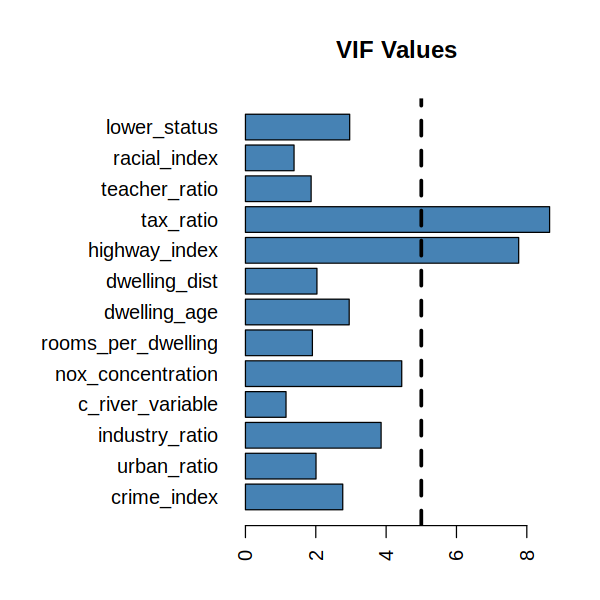

In [247]:
par(mar = c(3,10,4,2) + 0.1, mgp = c(3,1,0), cex.lab=0.9)

# create vector of VIF values
vif_values <- VIF(model)

#create horizontal bar chart to display each VIF value
barplot(vif_values, main = "VIF Values", horiz = TRUE, col = "steelblue", las=2)

# add vertical line at 5
abline(v = 5, lwd = 3, lty = 2)

- Parece ser que las variables predictoras (lower_status, rooms_per_dwelling y teacher_ratio) no presentan problemas de multicolinealidad.

- A continuación lo detallaremos para cada una de ellas.

## Modelo Lineal Múltiple

In [252]:
modelo_lm = lm(median_value ~ rooms_per_dwelling+lower_status+teacher_ratio , data = data_train) 

In [251]:
VIF(modelo_lm)

rooms_per_dwelling       lower_status      teacher_ratio 
          1.556478           1.645327           1.203028

- Los valores del VIF para los predictores rooms_per_dwelling, lower_status y teacher_ratio en el modelo de regresión lineal múltiple son inferiores a 2. 

- Podemos concluir que no hay ningún problema significativo de multicolinealidad en el modelo, y los 3 predictores pueden incluirse en el modelo sin afectar a la interpretación de los coeficientes.



In [253]:
summary(modelo_lm)


Call:
lm(formula = median_value ~ rooms_per_dwelling + lower_status + 
    teacher_ratio, data = data_train)

Residuals:
     Min       1Q   Median       3Q      Max 
-15.3387  -3.0678  -0.8601   1.9159  29.7962 

Coefficients:
                   Estimate Std. Error t value Pr(>|t|)    
(Intercept)        16.64272    4.71350   3.531 0.000479 ***
rooms_per_dwelling  4.78901    0.51304   9.335  < 2e-16 ***
lower_status       -0.59669    0.05592 -10.670  < 2e-16 ***
teacher_ratio      -0.90570    0.14909  -6.075 3.73e-09 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 5.248 on 302 degrees of freedom
Multiple R-squared:  0.6917,	Adjusted R-squared:  0.6886 
F-statistic: 225.9 on 3 and 302 DF,  p-value: < 2.2e-16


- El resultado muestra que las variables predictoras rooms_per_dwelling, lower_status y teacher_ratio están significativamente asociadas con la variable de respuesta median_value (como demuestran los p-values < 0.05). 

- El modelo de regresión tiene una R² múltiple de 0.6917, lo que indica que las variables predictoras pueden explicar el 69.17% de la varianza del valor medio del precio de la vivienda (En 1000USD).

- La R² ajustada tiene en cuenta el número de variables independientes del modelo. Ajusta el valor R² penalizando la adición de variables adicionales que no mejoran significativamente el ajuste del modelo, y sólo aumenta si la nueva variable independiente mejora el modelo más de lo que cabría esperar por azar. En este caso, La R² ajustada es de 0.6886, y refleja que la adición de la variable teacher_ratio mejoró ligeramente el modelo (aclaración: primero se realizó el modelo sin la variable teacher_ratio).


- La tabla de coeficientes proporciona las estimaciones de las pendientes de cada variable predictora en la ecuación de regresión:
    - El coeficiente de rooms_per_dwelling es de 4.79, lo que indica que por cada unidad de aumento en rooms_per_dwelling, se espera que el valor medio del precio de la vivienda (en 1000 USD) aumente en 4.79. 
    - El coeficiente de lower_status es -0.597, lo que indica que por cada unidad de aumento en lower_status, se espera que el valor medio del precio de la vivienda (en 1000 USD) disminuya en 0.597. 
    - El coeficiente de teacher_ratio es -0.906, lo que indica que por cada unidad de aumento de teacher_ratio, se espera que el valor medio del precio de la vivienda (en 1000 USD) disminuya en 0.906.

- Por tanto, los resultados sugieren que un aumento del número de habitaciones medio por vivienda y una disminución de del porcentaje de población de 'clase-baja' conducen a un aumento del valor medio del precio de la vivienda, mientras que un aumento de ratio de alumnos por profesor conduce a una disminución del valor medio del precio de la vivienda.

- Los valores VIF de las variables predictoras muestran una baja multicolinealidad (todos los valores son inferiores a 2), lo que sugiere que las variables predictoras no están muy correlacionadas entre sí.


- En general, los resultados sugieren que el modelo se ajusta moderadamente bien a los datos, y que las variables predictoras rooms_per_dwelling, lower_status y teacher_ratio son predictores significativos del valor medio del precio de la vivienda.

## Comprobación de los supuestos

Ahora debemos validar el modelo.

### Normalidad:


	Lilliefors (Kolmogorov-Smirnov) normality test

data:  modelo_lm$residuals
D = 0.12004, p-value = 1.735e-11


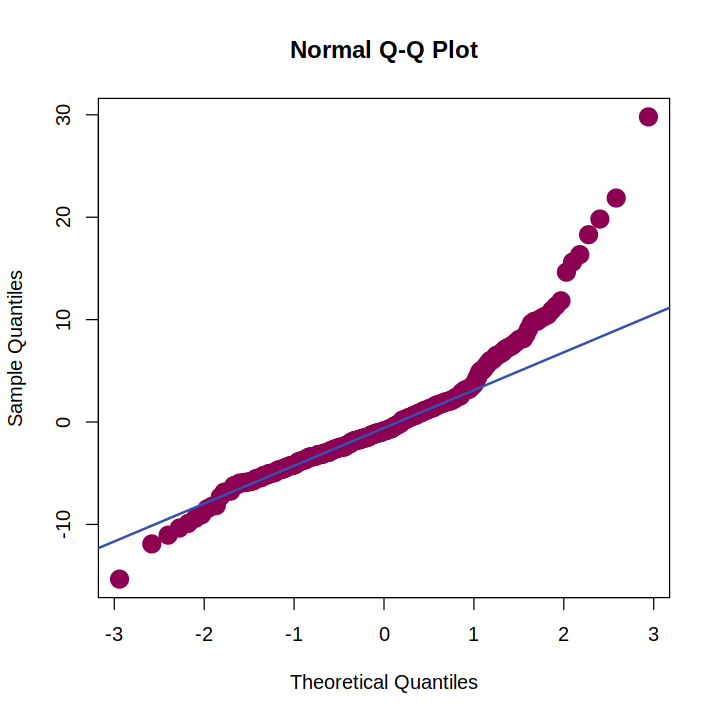

In [266]:
# Visualization
options(repr.plot.width = 6, repr.plot.height = 6)

qqnorm(modelo_lm$residuals,pch =19,col ="#8c0052", cex=2)
qqline(modelo_lm$residuals , col = "#3650b2", lwd = 2 )  

# Statistical Test
lillie.test(modelo_lm$residuals)

- Analizamos los residuos y vemos que NO se comportan con normalidad.
    - p-value < 0.05, por tanto, rechazamos la H0 de normalidad. 
- No se cumple el primer supuesto del modelo de regresión lineal.

### Homocedasticidad:

- Visualización: residuos vs valores ajustados.

- Prueba estadística: la prueba de Breusch-Pagan


	studentized Breusch-Pagan test

data:  modelo_lm
BP = 2.2693, df = 3, p-value = 0.5184


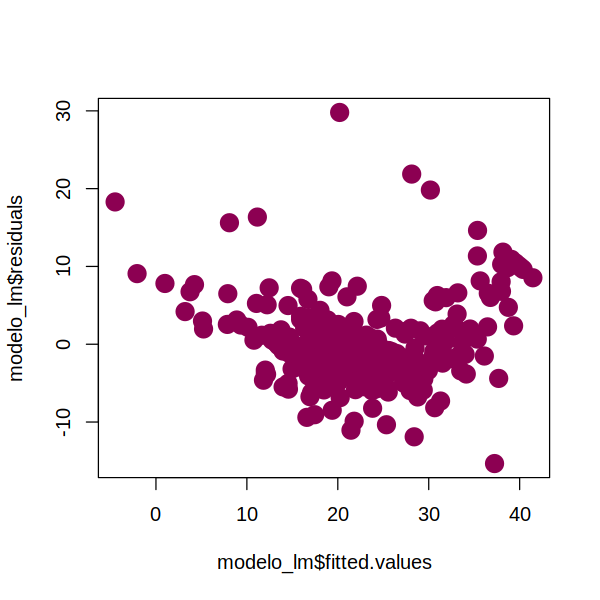

In [262]:
# Visualization
plot(modelo_lm$fitted.values , modelo_lm$residuals , pch =19,col ="#8c0052", cex=2 )

# Test Breusch-Pagan
bptest(modelo_lm)

- Se cumple.
- Si los residuos se dispersan aleatoriamente en torno a cero, indica que se cumple el supuesto de homocedasticidad.
- En este caso, el p-value > 0.05, por lo que no rechazamos la hipótesis nula y no podemos concluir que haya indicios de heteroscedasticidad en los residuos del modelo. 
- Esto significa que no se viola la hipótesis de homocedasticidad.

### Autocorrelación:

- Visualización: Residual vs Orden de toma de observaciones.
- Prueba estadística: la prueba de Durbin-Watson.

In [277]:
# para ver el nº residuos
str(modelo_lm$residuals)

 Named num [1:306] -7.3 1.93 5.45 1.31 6.09 ...
 - attr(*, "names")= chr [1:306] "1" "4" "5" "6" ...



	Durbin-Watson test

data:  modelo_lm
DW = 1.0555, p-value < 2.2e-16
alternative hypothesis: true autocorrelation is not 0


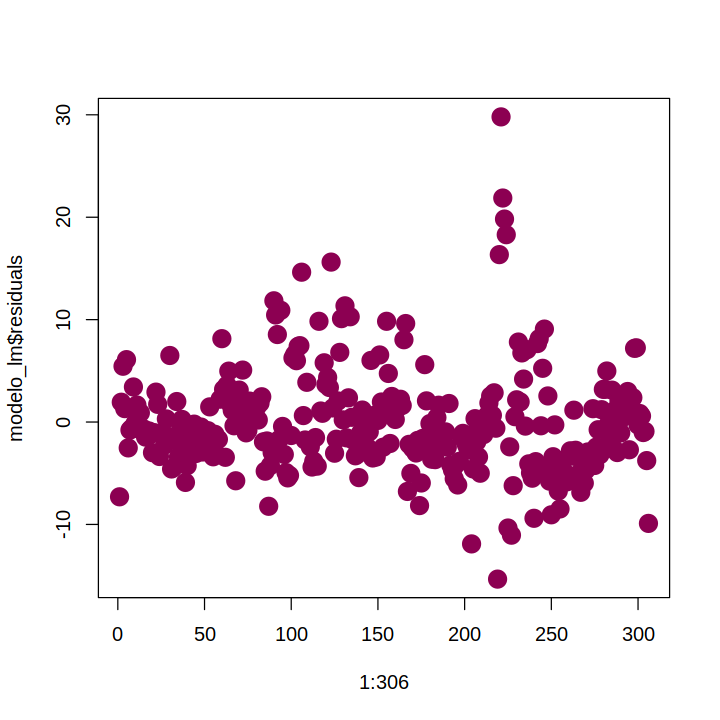

In [273]:
# Visualization
plot(1:306, modelo_lm$residuals, pch =19,col ="#8c0052", cex=2)

# Statistical Test
dwtest(modelo_lm,  alternative = c("two.sided"))

- Realizamos el gráfico de dispersión de los residuos del modelo de regresión lineal (modelo_lm) y la prueba de Durbin-Watson para comprobar la autocorrelación. 
- El gráfico de dispersión nos ayuda a visualizar la distribución y el patrón de los residuos. 
- La prueba de Durbin-Watson comprueba si hay autocorrelación en los residuos, lo que viola los supuestos de independencia requeridos para un modelo de regresión lineal. 
- El resultado de la prueba muestra que el p-value es muy pequeño (p-value < 2.2e-16), lo que indica una fuerte evidencia de autocorrelación positiva, lo que implica que los residuos no son independientes.

- Si existe una fuerte evidencia de autocorrelación positiva en los residuos, significa que los residuos no son independientes y, por tanto, viola los supuestos de un modelo de regresión lineal. 

- Esto puede llevar a una estimación incorrecta de los parámetros del modelo y a una inferencia incorrecta sobre su significancia estadística. 

- Como resultado, el modelo puede tener menor accuracy y sus predicciones pueden no ser fiables. 


### Media de errores:

In [278]:
mean(modelo_lm$residuals)

[1] -1.324399e-16

- La media de los residuos del modelo de regresión lineal es cercana a 0.
- Esto indica que el modelo tiene un buen equilibrio entre residuos positivos y negativos.
- Un buen modelo de regresión lineal debería tener residuos con una media cercana a 0. 


### Detección de Outliers:

Una tarea más es detectar si hay algún outlier en el conjunto de datos dado. Si hay un outliers, el resultado obtenido anteriormente no será confiable. Por tanto, existe la necesidad de detectarlos.

Visualización y Prueba estadística: la **Distancia de Cook** (estima la influencia de un punto en la regresión)

In [280]:
# valores de distancia de Cook para cada observación en el modelo de regresión
cooks_distance <- cooks.distance(modelo_lm)
print(cooks_distance)


           1            4            5            6            8           10 
5.751794e-03 3.935577e-04 2.652496e-03 1.361956e-04 7.002317e-03 1.000916e-03 
          14           16           19           20           22           23 
8.208209e-05 5.231960e-05 1.622097e-03 1.572919e-06 2.070411e-04 3.855538e-05 
          24           25           26           28           30           34 
6.916527e-05 3.172251e-05 3.920099e-05 1.608538e-04 2.021540e-04 6.060178e-05 
          35           36           38           39           40           42 
1.385436e-04 5.820840e-04 9.065499e-05 4.932664e-04 2.378642e-04 7.631717e-04 
          43           44           46           47           48           49 
1.213013e-04 6.359456e-05 4.318186e-04 4.843809e-06 1.563437e-04 1.372055e-02 
          52           53           54           55           57           59 
1.317423e-03 1.435413e-03 2.389047e-04 3.084442e-04 7.954660e-04 6.561708e-05 
          61           62           66           67 

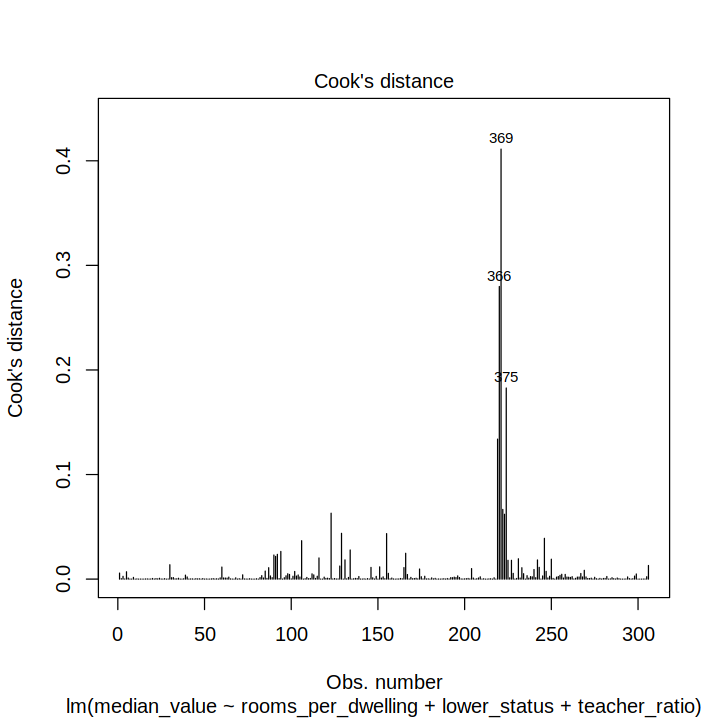

In [279]:
# Visualization (Cook's distance plot)
plot(modelo_lm , 4)

- Las observaciones con grandes valores de distancia de Cook se consideran valores atípicos o puntos influyentes, y pueden tener un impacto significativo en los coeficientes de regresión y en el ajuste general del modelo. 

- Observamos que hay outliers. 

Según los resultados obtenidos, no se cumplen los supuestos de normalidad e independencia de los residuos del modelo lineal. Los residuos no se distribuyen normalmente y presentan valores atípicos. Sin embargo, no se viola la hipótesis de homocedasticidad, lo que significa que la varianza de los residuos es coherente en todo el rango de las variables predictoras.

Aunque los resultados sugieren que el modelo puede no ser perfecto, sigue proporcionando un ajuste adecuado, como demuestran el valor R² múltiple de 0.69 y la significancia de las variables predictoras (como indican los bajos p-values). 

Que el modelo se considere "bueno" depende en última instancia del nivel de precisión de las predicciones.

## Predicciones y Conclusiones

A partir del conjunto de datos de prueba (test) verificamos el rendimiento del modelo (qué tan bien funcionará el modelo en datos desconocidos o no vistos).

R2,RMSE,MAE
<dbl>,<dbl>,<dbl>
0.6591304,5.225308,3.579823


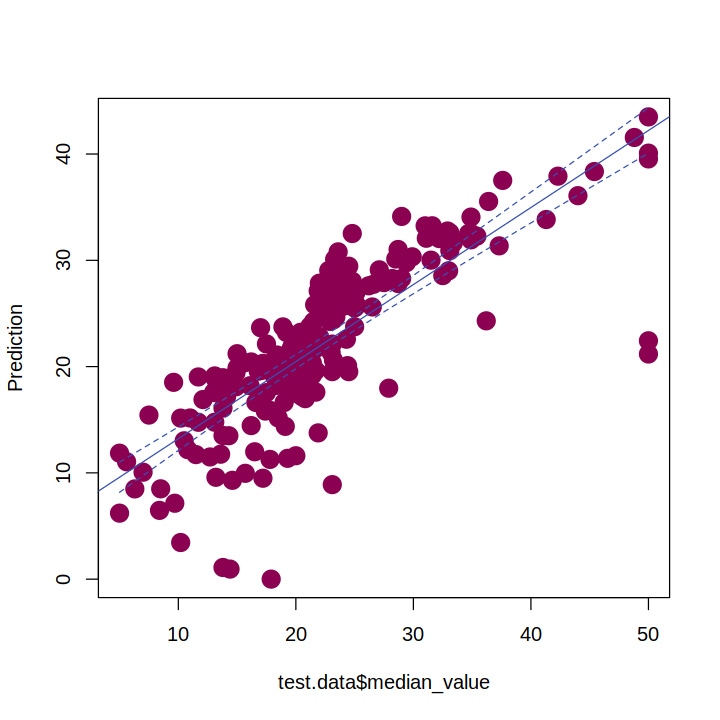

In [281]:
# Making prediction
prediction = predict(modelo_lm, data_test)

### Visualization
plot(data_test$median_value, prediction, xlab="test.data$median_value", ylab="Prediction", pch =19,col ="#8c0052", cex=2)

#add fitted regression line
lm.out = lm(prediction ~ median_value, data = data_test)
newx = seq(min(data_test$median_value),max(data_test$median_value),by = 0.05)
conf_interval = predict(lm.out, newdata=data.frame(median_value=newx), interval="confidence", level = 0.95)
abline(lm.out, col = "#3650b2")

#add conf_interval lines
lines(newx, conf_interval[,2], col="#3650b2", lty=2)
lines(newx, conf_interval[,3], col="#3650b2", lty=2)

# Statistical Measure
data.frame( R2 = R2(prediction, data_test$median_value),
            RMSE = RMSE(prediction, data_test$median_value),
            MAE = MAE(prediction, data_test$median_value))

- El valor R² de 0.66 indica que las variables predictoras (rooms_per_dwelling, lower_status y teacher_ratio) pueden explicar el 66% de la varianza del valor medio del precio de la vivienda (en 1000 USD) de los datos de prueba. 
- Sin embargo, el RMSE de 5.225308 sugiere que, de media, la predicción del modelo se equivoca en 5225.31 dólares. 
- El MAE de 3.579823 indica que la diferencia media entre el valor medio real y la predicción del modelo es de 3579.82 dólares. 
- Unos valores RMSE y MAE más bajos indicarían un mejor ajuste y unas predicciones más precisas. 
- Este modelo puede no ser el mejor modelo para este dataset, y un modelo más complejo o sofisticado podría proporcionar mejores predicciones, por ejemplo, modelos no lineales.
- También debemos tener en cuenta que probablemente el modelo hubiera mejorado si se hubieran tratado/eliminado los outliers de las variables antes de construir el modelo.
- Otras técnicas que podrían ayudar a mejorar los resultados del modelo son la regularización (puede ayudar a reducir el overfitting y mejorar la estabilidad del modelo), la feature selection (seleccionar sólo las características más importantes para minimizar el overfitting y mejorar la interpretabilidad del modelo) y la validación cruzada. 

## Referencias

[1] Chen, L.-P. (2021). Practical Statistics for Data Scientists. Technometrics (Vol. 63, pp. 272–273).

[2] Hastie, T., Tibshirani, R., James, G., & Witten, D. (2021). An introduction to Statistical Learning with Applications in R (2nd Edition). Springer Texts, 102, 618.

[3] Compare multiple sample variances in R. STHDA. Retrieved January 17, 2023, from http://www.sthda.com/english/wiki/compare-multiple-sample-variances-in-r 

[4] How to Calculate Variance Inflation Factor (VIF) in R. Retrieved January 26, 2023, from  https://www.statology.org/variance-inflation-factor-r/

